# How does player salary affect team performance? (NBA 1995-2017 Analysis)

![title](img/nba-background.jpg)

## Concepts to understand

### NBA Salary Cap ("The Cap")

Source: https://en.wikipedia.org/wiki/NBA_salary_cap
- The limit to the total amount of money that NBA teams are allowed to pay their players
    - Based on the percentage of the league's revenue from the season prior to the current 
- The cap is defined in their collective bargaining agreement (CBA), which has more complex rules and exceptions
- There are two important exceptions relevant to this investigation:
    1. rookie players (newcomers to the league) have a different type of contract to veteran players (they can't be paid as much)
    2. under certain circumstances it is possible to go over the salary cap
- I couldn't find the exact schedule of when they release the details about the cap nor the most updated cap info (hence why the analysis is using 1995-2017 data)

### Quick Overview of the NBA and Basketball Metrics

- There are 30 active teams in the NBA
- Each season consists of 82 games
    - A good indicator (for the general public) of whether a team is doing well is if they are 'over 500' which just means whether their win-loss ratio is >= 50%
- There are many basketball statistics, I've grouped them into <b>five categories</b> for convenience of analysis:
    - <b>Basic</b>: Not exactly related to basketball, and easily understood
        - age, position, minutes played, games played
    - <b>Regular</b>: Metrics of game events
        - shooting and shooting attempts (field-goals/field-goal attempts), 2-points vs 3-points, assisting (a basket), free throws (foul shots), etc
    - <b>Advanced</b>: Technical metrics (describe higher level concepts)
        - e.g. player efficiency (per), impact of player of the team (bpm), wins or expected wins share attributed to player, etc
    - <b>Secondary</b>: Theoretical metrics/formulae I found independently, which is not originally present in the dataset
        - e.g. approximate player value, trade value, estimated seasons left, etc.
    - <b>Numeric</b>: Superset of all the above categories

## Dataset Summary

I've used the <b>three datasets</b> outlined below:

|Dataset|Description|Size|Source|Data Collection|
|-|-|-|-|-|
|salary_cap.csv|NBA Salary caps (1984-2017)|Original: [r:33, c:3] <br> Filtered: [r:22, c:3]|https://www.basketball-reference.com/contracts/salary-cap-history.html|Figures are aggregated from official press releases directly from the NBA|
|nba_player_data.csv|Basic, advanced basketball statistics and player salaries for every season (1950-2017)|Original: [r:24.6k, c:54] <br> Filtered: [r:12.83k, c:54]|https://www.kaggle.com/whitefero/nba-players-advanced-season-stats-19782016/version/4| Specifics not disclosed, but validity seems reasonable as records were cross-referenced with ESPN, basketball-reference, and NBA official statistics, and yielded consistent results|
|team_wins.csv|Number of wins per team per season (1947-2018)|Original: [r:74, c:30] Filtered: [r:23 ,c:30]|https://www.basketball-reference.com/leagues/NBA_wins.html|Same as above|

These were filtered so all the data aligns within the same period 1995-2017<br>
<b>Why filter to 1995-2017?</b>
1. <u>Why isn't it more recent?</u> (until current 2019 season) because I couldn't find realiable resources for the salary cap after 2017 season
2. <u>Why isn't it beginning earlier?</u> I wanted to see if my own knowledge of players could be useful with some inferences later (and I'm not very familiar with the NBA before 1995)
    - The league also has some rule changes, which may influence the interpretability of the data

### Imports

In [563]:
#standard data science packages
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

#detect collinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor

#sklearn tools
from sklearn.preprocessing import StandardScaler, OneHotEncoder

#sklearn models
from sklearn.linear_model import LinearRegression, Ridge, Lasso, SGDRegressor, ElasticNet, Lars

from sklearn.tree import DecisionTreeRegressor, export_graphviz
from six import StringIO
from graphviz import Source

from sklearn.ensemble import BaggingRegressor, RandomForestRegressor, GradientBoostingRegressor

#evaluation and tuning
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, GridSearchCV

#display settings
%matplotlib inline
from IPython.core.display import display, HTML
from IPython.display import Image
display(HTML("<style>.container { width:100% !important; }</style>"))
sns.set(context='notebook', style="whitegrid", rc={"figure.figsize": (20, 10)})

pd.options.display.float_format = '{:20,.2f}'.format

### Utilities

In [674]:
# pandas utilities
MAX_ROWS = 60000
MAX_COLS = 200

def set_max_rows(v):
    MAX_ROWS = v
    
def set_max_cols(v):
    MAX_COLS = v

def print_pandas_ds(s, max_rows=MAX_ROWS, max_cols=MAX_COLS):
    with pd.option_context('display.max_rows', max_rows, 'display.max_columns', max_cols):
        display(s)

# plotting utilities
def plot_bar_chart(df,xlabel,ylabel,title, set_y_lim=False, min_y=0, max_y=50):
    graph = df.plot.bar(x=xlabel, y=ylabel)
    graph.set_title(title)
    if set_y_lim:
        graph.set_ylim(min_y, max_y)
    graph.plot()
    
def k_most_imp_with_j_heatmap(df, k, j, corr_method = 'pearson', title='Heatmap', return_top_vars=False, font_scale=1.25):
    """
    Plots a heatmap for the k variables most strongly (Pearson's) correlated with
    the variable j in df
    df = DataFrame
    k = int
    j = key of target column in df
    """
    corr_mtx = df.corr(method=corr_method, min_periods=1)
    r_square_mtx = corr_mtx ** 2
    k += 1
    cols = r_square_mtx.nlargest(k, j)[j].index
    corr = df[cols].corr()
    corr_square = corr ** 2
    
    f, ax = plt.subplots(figsize=(7, 7))
    sns.set(font_scale=font_scale)
    ax.set_title(title)
    mask = np.zeros_like(corr_square)
    mask[np.triu_indices_from(mask)] = True
    with sns.axes_style("white"):
        g = sns.heatmap(corr_square, mask=mask, square=True, 
                        xticklabels=corr_square.columns.values, 
                        yticklabels=corr_square.columns.values,
                        annot=True)
        plt.show()
        
    if return_top_vars:
        return corr_square        

def compute_vi_factor(df, round_result=False, num_decimals=2):
    """
    Returns new df containing variance inflation factor for each feature in df
    """
    df_vif = pd.DataFrame()
    df_vif['features'] = df.columns
    df_vif['vi_factor'] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
    if round_result:
        df_vif = df_vif.round(num_decimals)
    return df_vif
    
#sklearn utilities
#https://github.com/davidsbatista/machine-learning-notebooks/blob/master/hyperparameter-across-models.ipynb  
class EstimatorSelectionHelper:
    
    def __init__(self, models, params):
        self.models = models
        self.params = params
        self.keys = models.keys()
        self.grid_searches = {}
    
    def fit(self, X, y, **grid_kwargs):
        for key in self.keys:
            print('Running GridSearchCV for %s.' % key)
            model = self.models[key]
            params = self.params[key]
            grid_search = GridSearchCV(model, params, **grid_kwargs)
            grid_search.fit(X, y)
            self.grid_searches[key] = grid_search
        print('Done.')
    
    def score_summary(self, sort_by='mean_test_score'):
        frames = []
        for name, grid_search in self.grid_searches.items():
            frame = pd.DataFrame(grid_search.cv_results_)
            frame = frame.filter(regex='^(?!.*param_).*$')
            frame['estimator'] = len(frame)*[name]
            frames.append(frame)
        df = pd.concat(frames)
        
        df = df.sort_values([sort_by], ascending=False)
        df = df.reset_index()
        df = df.drop(['rank_test_score', 'index'], 1)
        
        columns = df.columns.tolist()
        columns.remove('estimator')
        columns = ['estimator']+columns
        df = df[columns]
        return df

## Data Cleaning

### nba_player_data.csv (df_stats)

In [3]:
#source: https://www.kaggle.com/whitefero/nba-players-advanced-season-stats-19782016/version/4
df_raw = pd.read_csv('nba_player_data.csv')
print_pandas_ds(df_raw.head(1))

,#,Season Start,Player Name,Player Salary in $,Pos,Age,Tm,G,GS,MP,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,blanl,OWS,DWS,WS,WS/48,blank2,OBPM,DBPM,BPM,VORP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
0,"11,999.00","1,995.00",A.C. Green,6473000,SF,31.00,PHO,82.00,52.00,"2,687.00",14.20,0.60,0.21,0.56,8.30,20.40,14.30,6.50,1.00,0.80,12.90,14.20,nan,4.60,2.10,6.70,0.12,nan,0.60,0.20,0.70,1.90,311.00,617.00,0.50,43.00,127.00,0.34,268.00,490.00,0.55,0.54,251.00,343.00,0.73,194.00,475.00,669.00,127.00,55.00,31.00,114.00,146.00,916.00


In [4]:
df_stats = df_raw.copy()

In [5]:
#drop unnecessary columns (rank, null columns)
cols_to_drop = ['#','blanl','blank2']
df_stats.drop(columns=cols_to_drop, inplace=True)

In [6]:
#rename columns, make everything lower case and replace spaces with _ for convinience
col_renaming_dict = {'Season Start': 'season',
                     'Tm': 'team',
                     'Player Name': 'name',
                     'Player Salary in $': 'salary',
                     'G': 'gp'}
df_stats.rename(index=str, columns=col_renaming_dict, inplace=True)
df_stats.columns = [c.lower().replace(' ', '_') for c in df_stats.columns]

In [7]:
#map player position categorical feature into a number
player_pos_mapper = {'PG': 1, 'SG': 2, 'SF': 3, 'PF': 4, 'C': 5}
df_stats['pos'] = df_stats['pos'].map(player_pos_mapper)

In [8]:
# add features (make statistics on a per/game (_pg) basis)
pg_stats_names = ['mp','orb','drb','trb',
                  'ast','stl','blk','tov','pf',
                  'pts','fg','fga','3p','3pa',
                  '2p','2pa','ft','fta']

for feature in pg_stats_names:
    df_stats[feature+'_pg'] = df_stats[feature]/df_stats['gp']
    
df_stats.drop(columns=pg_stats_names, inplace = True) #remove the total

df_stats['gs/gp'] = df_stats['gs']/df_stats['gp']

#https://www.nbastuffer.com/analytics101/approximate-value/
# #Credits=(Points)+(Rebounds)+(Assists)+(Steal)+(Blocks)-(Field Goals Missed)-(Free Throws Missed)-(Turnovers)
# #Approximate Value (AV) =  (Credits^(3/4))/21
df_stats['credits'] = df_stats.apply(lambda r: r['pts_pg']+r['trb_pg']+r['ast_pg']+r['stl_pg']+r['blk_pg']-r['fga_pg']-r['fta_pg']-r['tov_pg'], axis=1)
df_stats['apx_value'] = (df_stats['credits']**3/4)/21

#https://www.nbastuffer.com/analytics101/trade-value/
#http://www.rawbw.com/~deano/hoopla/append.html
# #Trade Value= (AV-Y)^2*(Y+1)*AV/190 + AV*Y^2/13
# #Y= 27- 0.75*Age
df_stats['seasons_left'] = df_stats.apply(lambda r: 27 - 0.75*r['age'], axis=1)
df_stats['trade_value'] = df_stats.apply(lambda r: ((((r['apx_value']-r['seasons_left'])**2)*(r['seasons_left']+1)*(r['apx_value']))/190) + ((r['apx_value'])*(r['seasons_left']**2))/13, axis=1)

# https://www.nbastuffer.com/analytics101/versatility-index/
# Versatility Index = [(PPG)*(RPG)*APG)]^(0.333)
df_stats['versatility'] = df_stats.apply(lambda r:((r['pts_pg'])*(r['trb_pg'])*(r['ast_pg']))**(1/3), axis=1)

In [9]:
# last row is irrelevant
df_stats=df_stats[:-1]

In [10]:
#cast salary from object to float
df_stats['salary'] = df_stats['salary'].astype(float)

In [11]:
#remove '*' found on some player names
df_stats['name'] = df_stats['name'].map(lambda r: r.rstrip('*'))

In [12]:
#'TOT' refers to players that were traded mid-season, conflicts with our cap idea to look at salary
df_stats=df_stats[~df_stats['team'].str.contains('TOT', na=False)]

#remove 'irrelevant rows' (simplified to games played > 15)
irrelevants_mask = df_stats['gp'] > 15
df_stats=df_stats[irrelevants_mask]

#drop rows w/o salary
df_stats=df_stats.dropna(subset=['salary'])

#if NaN is still present, it means that the player didn't attempt any shots
cols_with_nan = ['ts%', '3par', 'ftr', 'tov%', 'fg%', '3p%', '2p%', 'efg%', 'ft%']
for column in cols_with_nan:
    df_stats[column].fillna(0, inplace=True)

In [13]:
#double check null values
df_stats[df_stats.isnull().any(1)]

,season,name,salary,pos,age,team,gp,gs,per,ts%,...,2p_pg,2pa_pg,ft_pg,fta_pg,gs/gp,credits,apx_value,seasons_left,trade_value,versatility


In [14]:
#some teams have changed names during this time period, make the records reflect the 30 active teams
team_mapper={'CHH': 'NOP','NOH': 'NOP','NOK': 'NOP','NJN': 'BRK',
             'WSB': 'WAS','SEA': 'OKC','VAN': 'MEM','CHA': 'CHO'}
df_stats['team'].replace(to_replace=team_mapper, inplace=True)
len(df_stats['team'].unique())

30

### salary_cap.csv (cap_df)

In [15]:
#source: https://www.basketball-reference.com/contracts/salary-cap-history.html
cap_df = pd.read_csv('salary_cap.csv')
cap_df.set_index('Year', inplace=True)
print_pandas_ds(cap_df.head())

,Salary Cap
Year,
1995,23000000
1996,24363000
1997,26900000
1998,30000000
1999,34000000


In [16]:
#simple table, simple merge: use as dict to map the salary cap for that season onto the main df_stats DataFrame
cap_dict = cap_df.to_dict()
df_stats['cap'] = df_stats['season'].map(cap_dict['Salary Cap'])

#IMPORTANT: normalise salaries by making them a percentage of the salary cap for that year
df_stats['%_of_cap'] = (df_stats['salary']/df_stats['cap'])*100

- Measure the 'value of a player' by how much their salary occupies compared to the cap for the team that season
- Machine Learning Algorithms tend to perform better with smaller (and/or normalised) feature ranges

In [17]:
#source: https://www.basketball-reference.com/leagues/NBA_wins.html
df_team_wins_raw = pd.read_csv('team_wins.csv')
df_team_wins_raw.head(3)

,Season,ATL,BOS,BRK,CHI,CHO,CLE,DAL,DEN,DET,...,OKC,ORL,PHI,PHO,POR,SAC,SAS,TOR,UTA,WAS
0,2017,24,55,28,27,36.00,50,24,46,39,...,48,25,52,21,49,27,47,59,48,43
1,2016,43,53,20,41,36.00,51,33,40,37,...,47,29,28,24,41,32,61,51,51,49
2,2015,48,48,21,42,48.00,57,42,33,44,...,55,35,10,23,44,33,67,56,40,41


In [673]:
#manipulate to get the team wins table so it's easy to get average wins for each team
df_team_wins = df_team_wins_raw.copy()

df_team_wins.drop(columns='Season', inplace=True)

df_team_wins = df_team_wins.T

df_team_wins.index.name = 'teams'

df_team_wins['avg_wins'] = df_team_wins.mean(axis=1)
print_pandas_ds(df_team_wins['avg_wins'].head())

teams
ATL                  38.22
BOS                  40.87
BRK                  33.83
CHI                  40.83
CHO                  36.05
Name: avg_wins, dtype: float64

## EDA

In [684]:
print_pandas_ds(df_stats.head(5))

,season,name,pos,age,team,gp,gs,per,ts%,3par,ftr,orb%,drb%,trb%,ast%,stl%,blk%,tov%,usg%,ows,dws,ws,ws/48,obpm,dbpm,bpm,vorp,fg%,3p%,2p%,efg%,ft%,mp_pg,orb_pg,drb_pg,trb_pg,ast_pg,stl_pg,blk_pg,tov_pg,pf_pg,pts_pg,fg_pg,fga_pg,3p_pg,3pa_pg,2p_pg,2pa_pg,ft_pg,fta_pg,gs/gp,credits,apx_value,seasons_left,trade_value,versatility,cap,%_of_cap,lin_reg_predicted_%_of_cap,lin_reg_residuals,lin_reg_residual%,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%,Lars_predicted_%_of_cap,Lars_residuals,Lars_residual%,SGDRegressor_predicted_%_of_cap,SGDRegressor_residuals,SGDRegressor_residual%,BaggingRegressor_predicted_%_of_cap,BaggingRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_predicted_%_of_cap,DecisionTreeRegressor_residuals,DecisionTreeRegressor_residual%,GradientBoostingRegressor_predicted_%_of_cap,GradientBoostingRegressor_residuals,GradientBoostingRegressor_residual%,RandomForestRegressor_predicted_%_of_cap,RandomForestRegressor_residuals,RandomForestRegressor_residual%
0,"1,995.00",A.C. Green,3.00,31.00,PHO,82.00,52.00,14.20,0.60,0.21,0.56,8.30,20.40,14.30,6.50,1.00,0.80,12.90,14.20,4.60,2.10,6.70,0.12,0.60,0.20,0.70,1.90,0.50,0.34,0.55,0.54,0.73,32.77,2.37,5.79,8.16,1.55,0.67,0.38,1.39,1.78,11.17,3.79,7.52,0.52,1.55,3.27,5.98,3.06,4.18,0.63,8.83,8.19,3.75,12.91,5.21,23000000,28.14,14.30,13.85,49.20,14.32,13.82,49.11,14.14,14.00,49.75,14.21,13.93,49.50,15.12,13.03,46.29,"164,746,411,093,833,986,080,768.00","-164,746,411,093,833,986,080,768.00","-585,380,419,459,011,527,573,504.00",11.14,17.00,60.41,11.17,16.97,60.31,13.82,14.33,50.90,13.11,15.03,53.41
1,"1,995.00",Aaron McKie,2.00,22.00,POR,45.00,20.00,13.30,0.50,0.11,0.28,4.60,13.50,8.80,15.90,2.20,1.40,11.70,17.00,0.80,1.20,2.00,0.12,-1.20,1.30,0.10,0.40,0.44,0.39,0.45,0.47,0.69,18.38,0.78,2.09,2.87,1.98,0.80,0.36,0.87,2.16,6.51,2.58,5.80,0.24,0.62,2.33,5.18,1.11,1.62,0.44,4.22,0.90,10.50,12.60,3.33,23000000,3.67,4.49,-0.82,-22.32,5.25,-1.57,-42.83,5.39,-1.72,-46.75,5.67,-2.00,-54.36,6.32,-2.64,-71.93,"164,746,411,095,457,617,936,384.00","-164,746,411,095,457,617,936,384.00","-4,484,221,840,468,076,958,580,736.00",3.28,0.40,10.76,2.60,1.07,29.25,3.67,0.00,0.00,3.68,-0.00,-0.06
4,"1,995.00",Acie Earl,5.00,24.00,BOS,30.00,3.00,6.60,0.41,0.00,0.43,10.40,14.60,12.50,1.40,1.50,2.60,14.80,19.70,-0.40,0.20,-0.20,-0.04,-6.80,-1.90,-8.70,-0.40,0.38,0.00,0.38,0.38,0.48,6.93,0.63,0.87,1.50,0.07,0.20,0.27,0.47,1.30,2.20,0.87,2.27,0.00,0.00,0.87,2.27,0.47,0.97,0.10,0.53,0.00,9.00,0.02,0.60,23000000,4.52,5.70,-1.18,-26.16,5.48,-0.95,-21.09,3.81,0.71,15.63,3.25,1.27,28.04,3.64,0.89,19.61,"164,746,411,045,222,573,146,112.00","-164,746,411,045,222,573,146,112.00","-3,643,430,244,269,344,814,006,272.00",1.90,2.62,58.01,2.60,1.92,42.51,3.38,1.15,25.36,2.11,2.42,53.44
5,"1,995.00",Adam Keefe,3.00,24.00,UTA,75.00,0.00,15.10,0.62,0.00,0.58,14.00,18.00,16.10,3.50,1.50,1.60,14.20,15.60,2.40,1.70,4.10,0.15,0.60,0.20,0.80,0.90,0.58,0.00,0.58,0.58,0.68,16.93,1.80,2.56,4.36,0.40,0.48,0.33,0.83,1.88,6.15,2.29,3.97,0.00,0.00,2.29,3.97,1.56,2.31,0.00,4.61,1.17,9.00,11.06,2.20,23000000,7.17,5.20,1.97,27.46,5.50,1.67,23.33,3.13,4.04,56.31,3.91,3.27,45.53,6.00,1.17,16.36,"164,746,411,087,806,368,579,584.00","-164,746,411,087,806,368,579,584.00","-2,296,465,124,254,270,791,614,464.00",5.54,1.64,22.81,4.26,2.91,40.59,5.36,1.81,25.22,5.46,1.72,23.94
11,"1,995.00",Alonzo Mourning,5.00,24.00,NOP,77.00,77.00,20.10,0.59,0.03,0.58,8.40,21.60,15.30,6.60,0.90,5.50,14.80,25.60,4.30,5.10,9.40,0.15,-0.80,2.10,1.30,2.50,0.52,0.32,0.53,0.52,0.76,38.19,2.60,7.29,9.88,1.44,0.64,2.92,3.13,3.57,21.34,7.42,14.30,0.14,0.44,7.27,13.86,6.36,8.36,1.00,10.43,13.50,9.00,98.53,6.72,23000000,19.83,26.74,-6.92,-34.89,25.42,-5.60,-28.23,22.08,-2.25,-11.36,22.37,-2.54,-12.84,22.96,-3.13,-15.80,"164,746,411,441,253,152,456,704.00","-164,746,411,441,253,152,456,704.00","-830,957,777,006,32

In [19]:
print_pandas_ds(df_stats.describe())

,season,salary,pos,age,gp,gs,per,ts%,3par,ftr,orb%,drb%,trb%,ast%,stl%,blk%,tov%,usg%,ows,dws,ws,ws/48,obpm,dbpm,bpm,vorp,fg%,3p%,2p%,efg%,ft%,mp_pg,orb_pg,drb_pg,trb_pg,ast_pg,stl_pg,blk_pg,tov_pg,pf_pg,pts_pg,fg_pg,fga_pg,3p_pg,3pa_pg,2p_pg,2pa_pg,ft_pg,fta_pg,gs/gp,credits,apx_value,seasons_left,trade_value,versatility,cap,%_of_cap
count,"7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00","7,682.00"
mean,"2,006.62","4,732,929.36",3.03,26.83,58.29,30.41,13.79,0.52,0.21,0.30,5.83,14.45,10.14,13.49,1.63,1.62,13.95,18.96,1.67,1.47,3.14,0.09,-0.81,-0.13,-0.94,0.79,0.45,0.25,0.47,0.48,0.73,23.16,1.12,2.93,4.05,2.07,0.74,0.47,1.36,2.08,9.38,3.51,7.79,0.60,1.69,2.91,6.10,1.75,2.34,0.47,5.23,3.82,6.88,60.83,3.91,"52,999,590.99",9.15
std,6.68,"4,844,617.12",1.42,4.20,20.28,29.40,4.36,0.06,0.20,0.15,3.95,5.67,4.48,9.34,0.66,1.60,4.24,4.86,2.19,1.22,3.07,0.06,2.63,1.75,3.05,1.47,0.06,0.17,0.06,0.06,0.12,9.28,0.87,1.76,2.50,1.89,0.44,0.51,0.78,0.73,5.81,2.12,4.53,0.68,1.78,1.93,3.87,1.42,1.80,0.41,3.11,6.92,3.15,470.08,2.22,"19,612,495.68",8.83
min,"1,995.00","8,819.00",1.00,18.00,16.00,0.00,-1.70,0.18,0.00,0.00,0.00,3.00,1.80,0.00,0.00,0.00,0.00,3.70,-3.30,-0.60,-2.10,-0.23,-11.20,-6.10,-14.50,-2.60,0.16,0.00,0.00,0.16,0.00,1.88,0.00,0.06,0.18,0.00,0.00,0.00,0.00,0.15,0.25,0.12,0.29,0.00,0.00,0.00,0.09,0.00,0.00,0.00,-1.63,-0.05,-5.25,-31.72,0.00,"23,000,000.00",0.01
25%,"2,001.00","1,348,530.00",2.00,24.00,42.00,3.00,11.00,0.49,0.01,0.20,2.40,9.80,6.30,6.70,1.20,0.50,11.00,15.50,0.20,0.50,0.80,0.05,-2.50,-1.30,-2.90,-0.10,0.41,0.00,0.43,0.45,0.67,15.68,0.45,1.66,2.22,0.75,0.41,0.14,0.76,1.56,4.82,1.83,4.18,0.00,0.06,1.42,3.08,0.73,1.04,0.06,2.89,0.29,4.50,0.89,2.17,"40,271,000.00",2.72
50%,"2,007.00","3,000,000.00",3.00,26.00,63.00,20.00,13.60,0.53,0.19,0.28,4.70,13.50,9.30,10.50,1.50,1.10,13.40,18.70,1.00,1.10,2.30,0.09,-0.80,-0.20,-0.90,0.30,0.44,0.31,0.47,0.48,0.75,23.17,0.86,2.54,3.43,1.47,0.66,0.30,1.18,2.08,8.17,3.11,6.92,0.35,1.16,2.44,5.17,1.34,1.83,0.38,4.73,1.26,7.50,5.16,3.50,"55,630,000.00",6.21
75%,"2,013.00","6,250,000.00",4.00,30.00,77.00,58.00,16.30,0.56,0.36,0.38,8.90,18.40,13.60,17.90,2.00,2.20,16.20,22.10,2.60,2.10,4.60,0.13,0.80,1.00,0.90,1.30,0.48,0.37,0.51,0.52,0.81,30.97,1.58,3.75,5.25,2.77,0.99,0.60,1.81,2.60,12.79,4.81,10.64,1.04,2.88,3.99,8.33,2.35,3.10,0.97,7.04,4.15,9.00,19.60,5.25,"58,680,000.00",12.48
max,"2,017.00","34,682,550.00",5.00,43.00,82.00,82.00,31.70,0.76,0.94,1.58,22.50,38.00,29.70,57.30,5.90,15.10,40.70,41.70,14.80,9.10,20.40,0.34,12.40,7.50,15.60,12.40,0.75,1.00,0.75,0.75,1.00,43.05,6.82,11.41,16.80,12.33,2.94,4.49,5.73,4.52,35.40,12.22,27.16,5.09,11.22,12.10,22.96,9.22,13.14,1.00,18.84,79.63,13.50,"17,529.63",15.17,"99,093,000.00",123.71


Observations:
- Large `salary` range [8.8k, 34.6m], compared to `%_of_cap` which is [0.01, 123.71]
- The `cap` std is quite large ~20m
- Negative values are present only on the `advanced` and `secondary` statistics
- The `count` 7.6k is reasonably large despite the aggressive data cleaning strategies used (e.g. drop NaN salary, drop players with less than 15 games played

### Exploring some averages per season (interesting trends?)

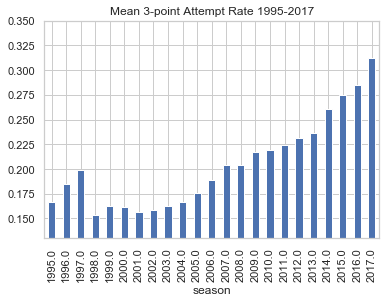

In [20]:
plot_bar_chart(df_stats.groupby('season')['3par'].mean(), 'Season', 'Mean 3-point Attempt Rate', 'Mean 3-point Attempt Rate 1995-2017',True, 0.13, 0.35)

Increasing average 3-point shot attempt rate per season

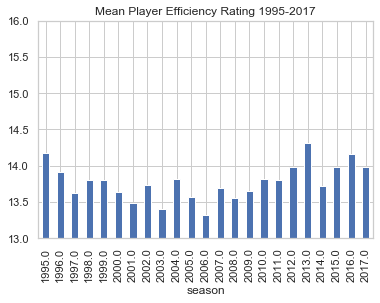

In [21]:
plot_bar_chart(df_stats.groupby('season')['per'].mean(), 'Season', 'Mean Player Efficiency Rating', 'Mean Player Efficiency Rating 1995-2017', True, 13, 16)

No particular trend found in terms of player efficiency rating (per) 

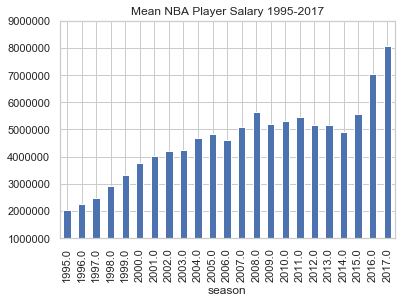

In [22]:
plot_bar_chart(df_stats.groupby('season')['salary'].mean(), 'Season', 'Mean Salary', 'Mean NBA Player Salary 1995-2017',True, 1*10**6, 9*10**6)

The mean salary for players is increasing!! 

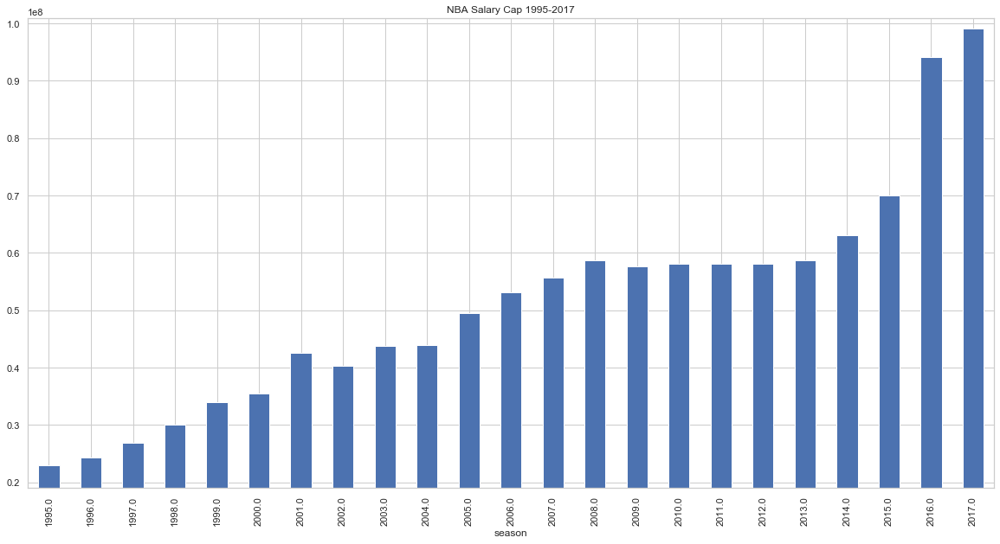

In [679]:
plot_bar_chart(df_stats.groupby('season')['cap'].mean(), 'Season', 'Cap', 'NBA Salary Cap 1995-2017', True, 0.19*10**8,1.01*10**8)

As expected this means that the cap is also increasing!! 

In [23]:
#separate salary from main df (since it determines machine learning target %_of_cap)
df_salary = df_stats['salary']
df_stats.drop(columns='salary', inplace=True)

### Explore Correlations

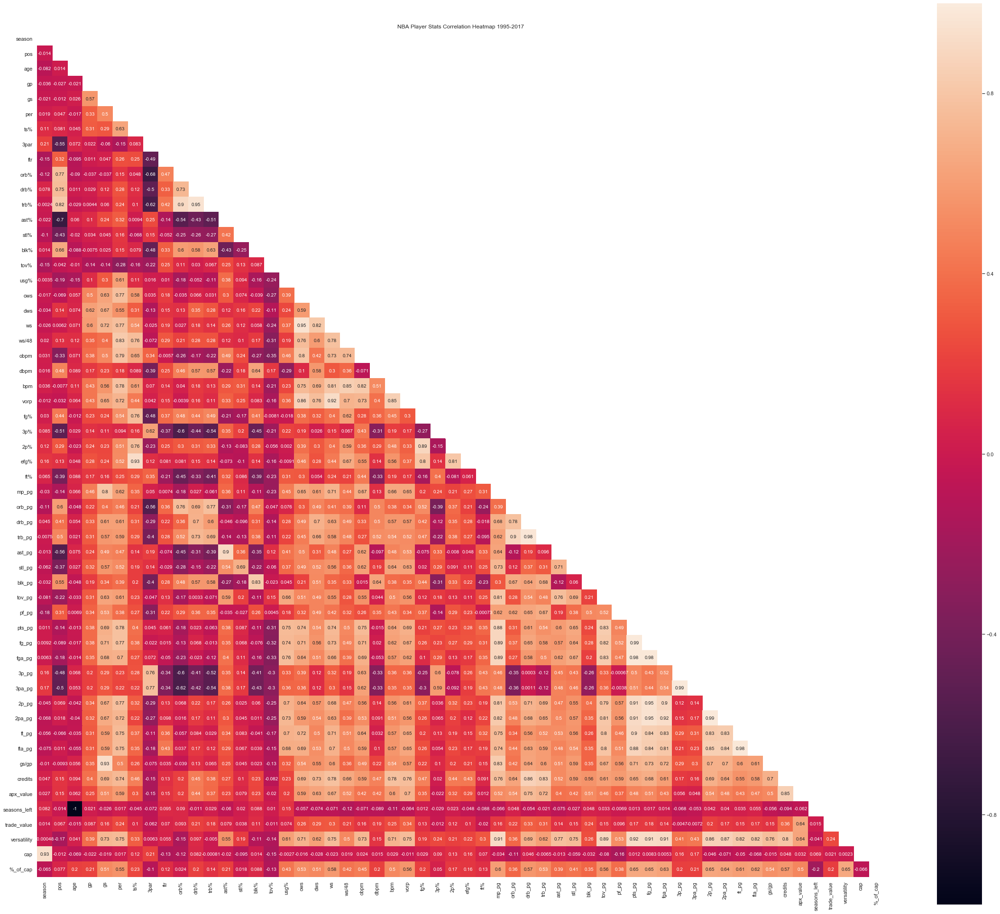

In [24]:
corr = df_stats.corr()
plt.subplots(figsize=(40,35))
ax = plt.axes()
ax.set_title("NBA Player Stats Correlation Heatmap 1995-2017")
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    g = sns.heatmap(corr, mask=mask, square=True, 
                     xticklabels=corr.columns.values, 
                     yticklabels=corr.columns.values,
                     annot=True)

- Too tedious to infer from such a large heatmap, so I just want the strongest ones with respect to `%_of_cap`
- Since <b>my baseline model will be a linear regression</b>, it is standard practice to explore Pearson's correlation instead of Spearman's correlation coefficient
    - source: https://www.researchgate.net/post/Which_correlation_coefficient_is_better_to_use_Spearman_or_Pearson

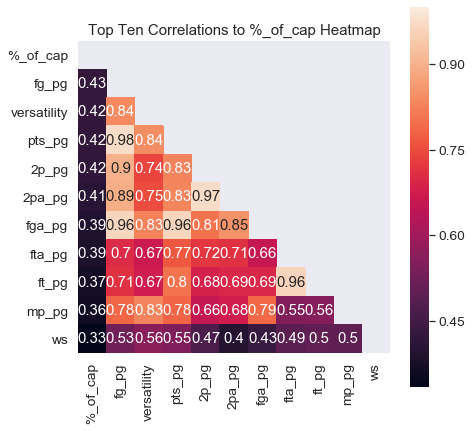

In [28]:
k_most_imp_with_j_heatmap(df_stats, 10, '%_of_cap', "Top Ten Correlations to %_of_cap Heatmap")

- Strongest correlations are with shooting related statistics, or minutes played
- Also good to know that versatility (a `secondary` statistic) is highly rated (goes to show our preliminary feature engineering was beneficial)

In [26]:
df_stats.columns

Index(['season', 'name', 'pos', 'age', 'team', 'gp', 'gs', 'per', 'ts%',
       '3par', 'ftr', 'orb%', 'drb%', 'trb%', 'ast%', 'stl%', 'blk%', 'tov%',
       'usg%', 'ows', 'dws', 'ws', 'ws/48', 'obpm', 'dbpm', 'bpm', 'vorp',
       'fg%', '3p%', '2p%', 'efg%', 'ft%', 'mp_pg', 'orb_pg', 'drb_pg',
       'trb_pg', 'ast_pg', 'stl_pg', 'blk_pg', 'tov_pg', 'pf_pg', 'pts_pg',
       'fg_pg', 'fga_pg', '3p_pg', '3pa_pg', '2p_pg', '2pa_pg', 'ft_pg',
       'fta_pg', 'gs/gp', 'credits', 'apx_value', 'seasons_left',
       'trade_value', 'versatility', 'cap', '%_of_cap'],
      dtype='object')

In [680]:
#splitting the feature groups as described initially
advanced = ['%_of_cap', 'per', 'ts%', '3par', 'ftr', 'orb%', 'drb%', 'trb%', 'ast%', 'stl%', 'blk%', 'tov%', 'usg%', 'ows', 'dws', 'ws', 'ws/48', 'obpm', 'dbpm', 'bpm', 'vorp']
regular = ['%_of_cap', 'orb_pg', 'drb_pg', 'trb_pg', 'ast_pg', 'stl_pg', 'blk_pg', 'tov_pg', 'pf_pg', 'fg_pg','fga_pg', '3p_pg', '3pa_pg', '2p_pg', '2pa_pg','ft_pg','fta_pg']
basic = ['%_of_cap', 'pos', 'age', 'mp_pg', 'gp']
secondary = ['%_of_cap', 'credits', 'apx_value', 'seasons_left', 'trade_value', 'versatility']
numeric_features = [c for c in df_stats.columns 
                    if not ('residual' in c or 'season' in c or 'predicted' in c or 'name' in c or 'team' in c or '%_of_cap' in c)]
col_groups = {'adv': advanced,
              'reg': regular,
              'bsc': basic,
              'sec': secondary,
              'num': numeric_features,
              'all': df_stats.columns}

In [51]:
df_stats_advanced = df_stats[col_groups['adv']].copy()
df_stats_regular = df_stats[col_groups['reg']].copy()
df_stats_basic = df_stats[col_groups['bsc']].copy()
df_stats_secondary = df_stats[col_groups['sec']].copy()

In [45]:
print(len(df_stats_advanced.columns))
print(len(df_stats_regular.columns))
print(len(df_stats_basic.columns))
print(len(df_stats_secondary.columns))

21
17
5
6


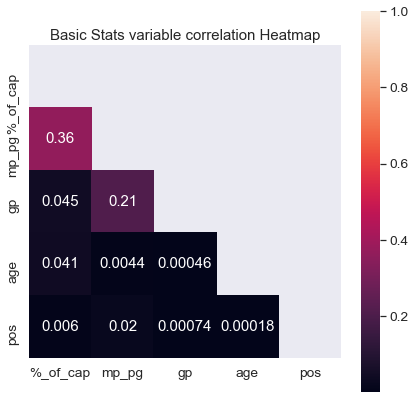

In [33]:
#explore top correlations per feature group
k_most_imp_with_j_heatmap(df_stats_basic, 5, '%_of_cap', "Basic Stats variable correlation Heatmap")

/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:488: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


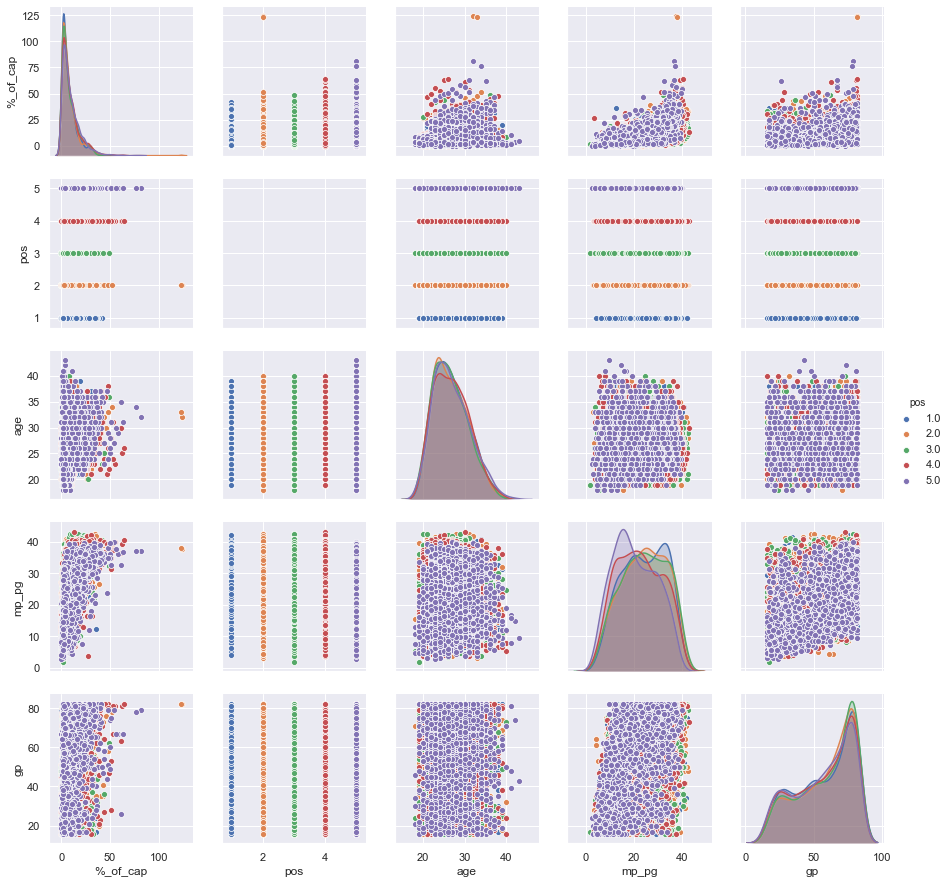

In [34]:
sns.set()
basic_pp_g = sns.pairplot(df_stats_basic, height=2.5, hue='pos')

- Despite being normalised, `%_of_cap` has quite a skewed distribution
- <b>No significantly strong linear characteristics found relative to `%_of_cap`</b>
- There are some extreme values based on position (particularly 2 i.e. SG position)
- No visibly significant distribution differences in terms of `age` (recall mean age was about 26)
- `gp` distribution is interesting, perhaps shows the regular players versus the reserve players
- `mp_pg` has some distribution differences based on player position

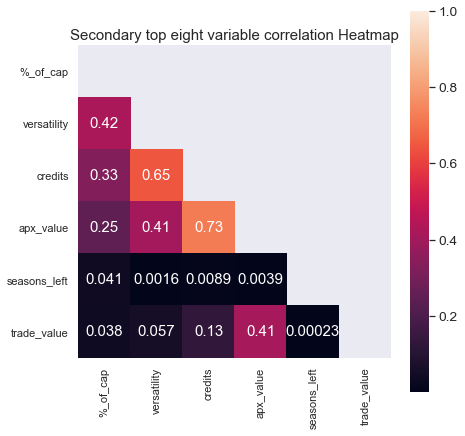

In [46]:
df_sec_corrs = k_most_imp_with_j_heatmap(df_stats_secondary, 6, '%_of_cap', "Secondary top eight variable correlation Heatmap", return_top_vars=True)

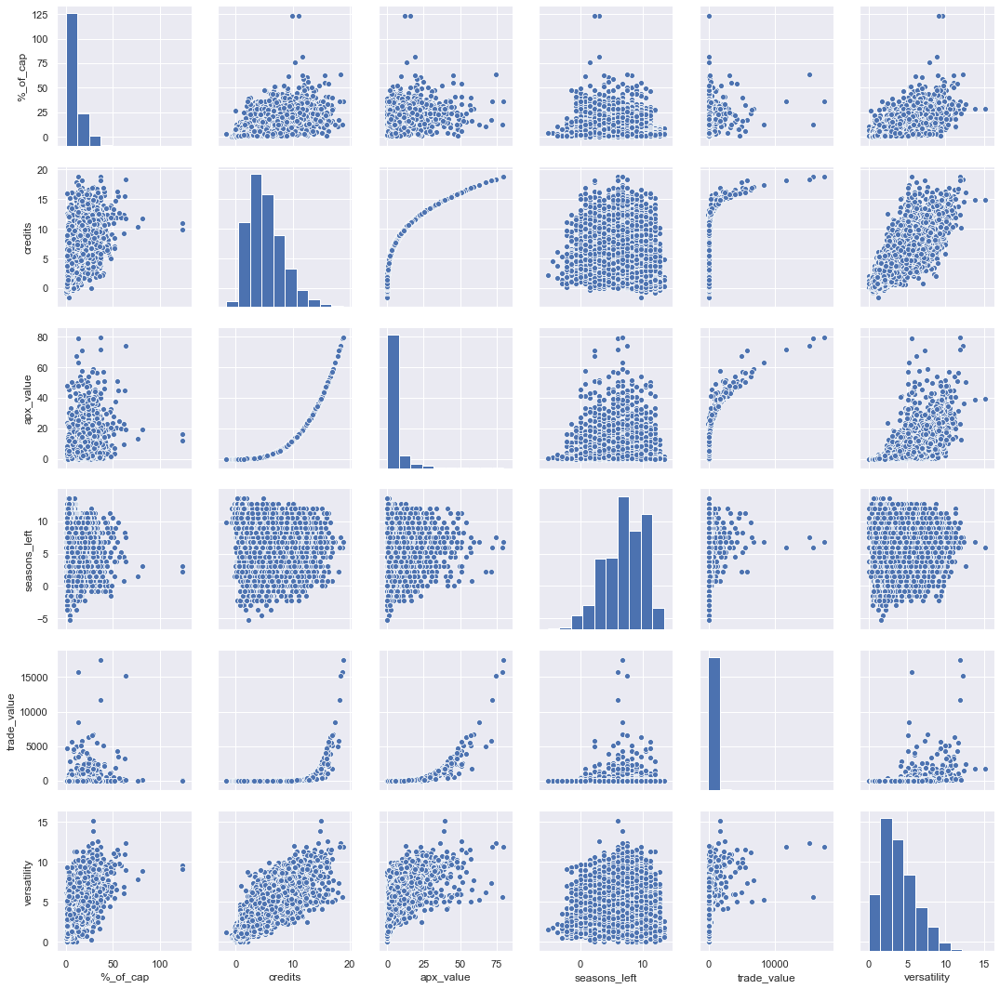

In [38]:
sns.set()
secondary_pp_g = sns.pairplot(df_stats_secondary, height=2.5)

- `secondary` statistics group also <b>found no significantly strong linear characteristics with `%_of_cap` </b>
- extreme values also detected

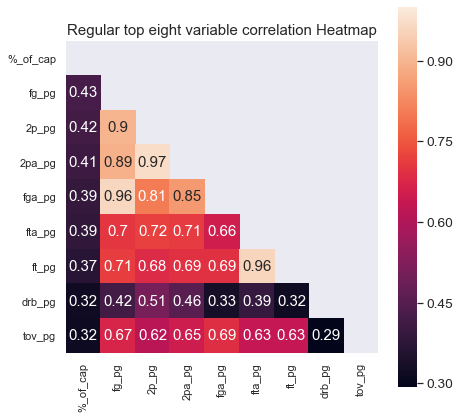

In [39]:
df_reg_corrs = k_most_imp_with_j_heatmap(df_stats_regular, 8, '%_of_cap', "Regular top eight variable correlation Heatmap", return_top_vars=True)

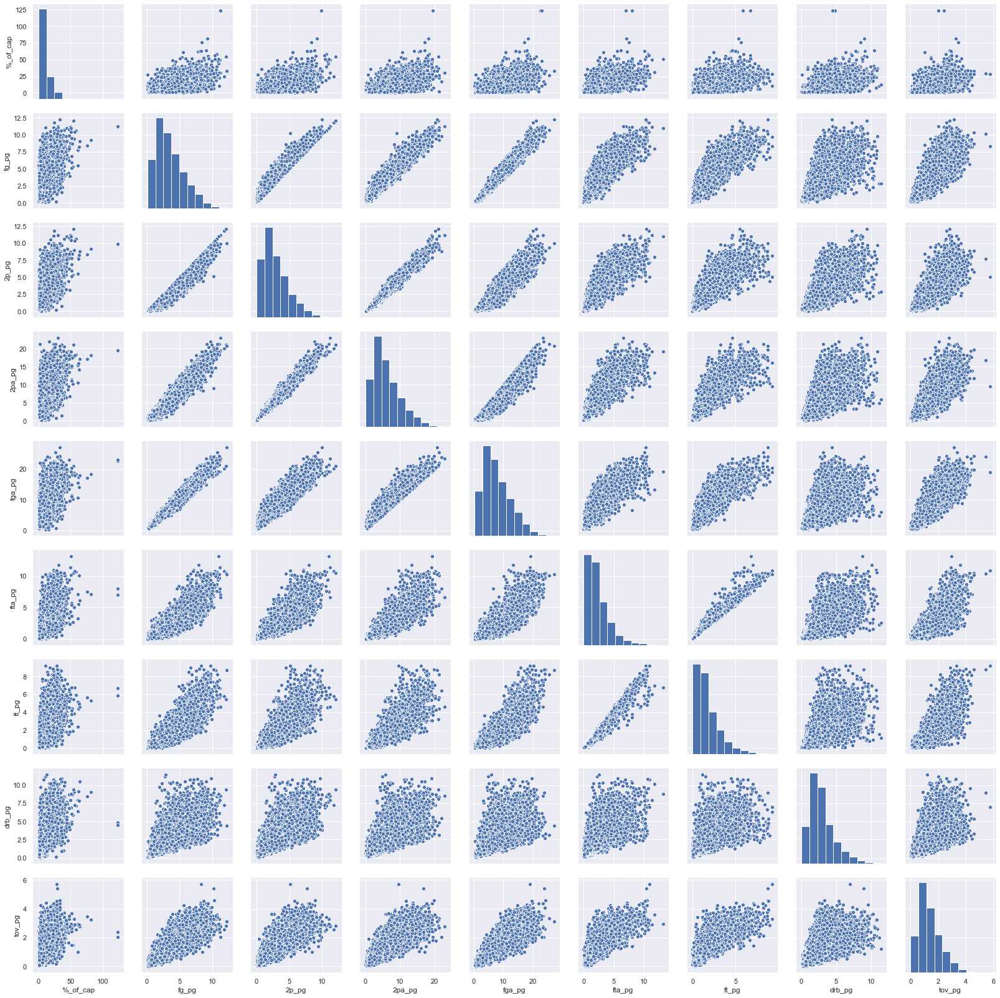

In [40]:
sns.set()
regular_pp_g = sns.pairplot(df_stats[df_reg_corrs.columns], height=2.5)

- `regular` statistics group also <b><u>found some significantly strong linear characteristics with `%_of_cap` </u></b>
- extreme values also detected

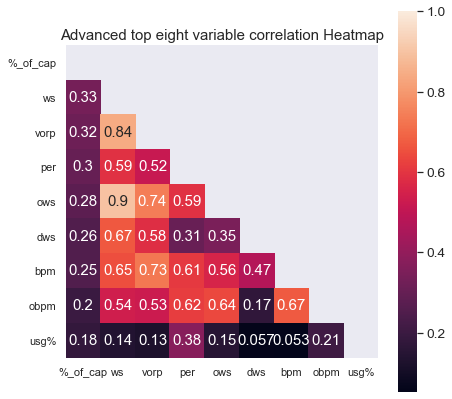

In [41]:
df_adv_corrs = k_most_imp_with_j_heatmap(df_stats_advanced, 8, '%_of_cap', "Advanced top eight variable correlation Heatmap", return_top_vars=True)

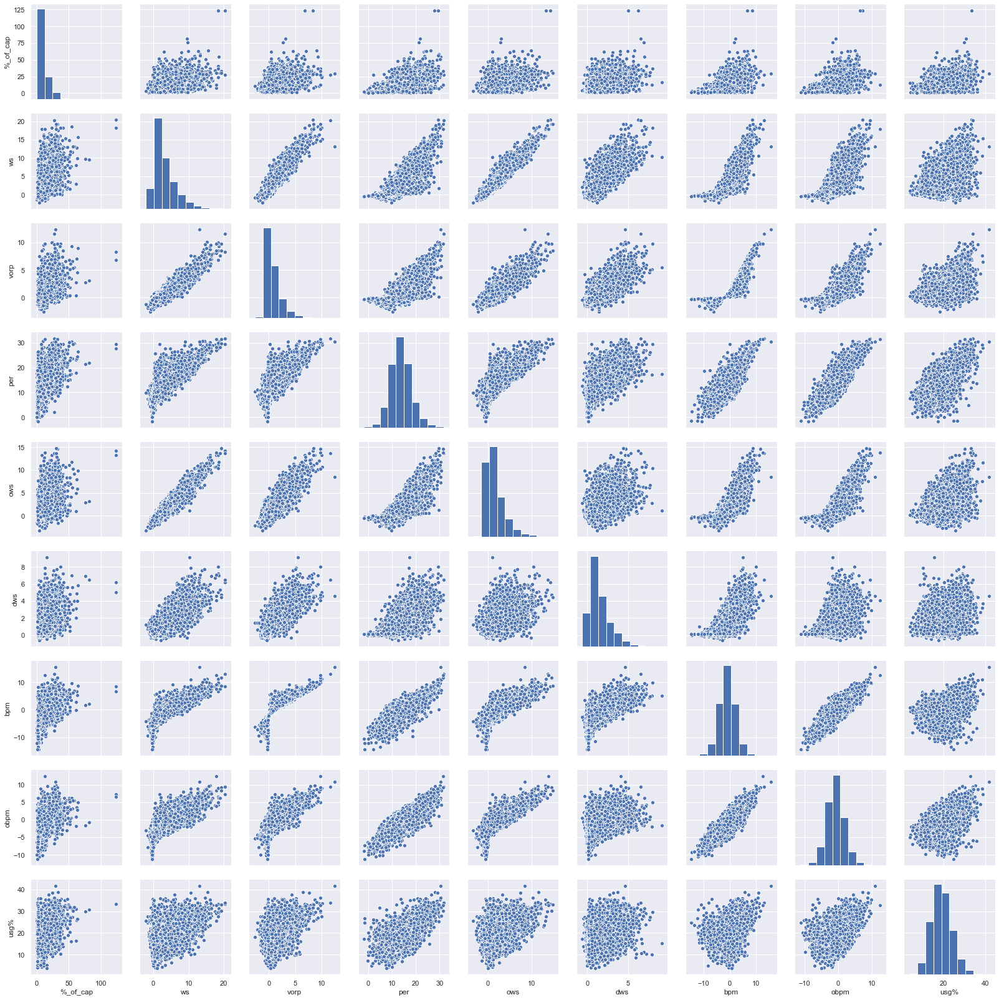

In [42]:
sns.set()
adv_pp_g = sns.pairplot(df_stats[df_adv_corrs.columns], height=2.5)

- `advanced` statistics group also <b><u>found some significantly strong linear characteristics with `%_of_cap` </u></b>
- extreme values also detected

### Checking for Multicollinear Features

- Multicollinear features may worsen model performance specifically linear ones and (non-ensemble tree). This seems to be less of an issue for ensemble models.
- Variance inflation factor is a measure for multicollinearity

sources:
- https://www.quora.com/Is-multicollinearity-a-problem-with-gradient-boosted-trees 
- https://stats.stackexchange.com/questions/141619/wont-highly-correlated-variables-in-random-forest-distort-accuracy-and-feature
- https://en.wikipedia.org/wiki/Variance_inflation_factor

In [47]:
#seems like a few variables might be multi-collinear, 
#double check top eight correlations for each type of stat (except %_of_cap)
adv_feats_cols = df_adv_corrs.columns.to_list()[1:]
df_adv = df_stats_advanced[adv_feats_cols]
reg_feats_cols = df_reg_corrs.columns.to_list()[1:]
df_reg = df_stats_regular[reg_feats_cols]
basic_feats_cols = df_stats_basic.columns.to_list()[1:]
df_basic = df_stats_basic[basic_feats_cols]
secondary_feats_cols = df_stats_secondary.columns.to_list()[1:]
df_secondary = df_stats_secondary[secondary_feats_cols]

In [48]:
df_vi_factor = compute_vi_factor(df_adv, round_result=True)
df_vi_factor

,features,vi_factor
0,ws,"7,873.35"
1,vorp,14.16
2,per,53.30
3,ows,"3,099.26"
4,dws,"1,495.85"
5,bpm,15.82
6,obpm,8.29
7,usg%,55.03


In [53]:
#try removing ows and dws to see if we can lower vi_factor
adv_feats_cols

['ws', 'vorp', 'per', 'dws', 'bpm', 'obpm', 'usg%']

In [54]:
adv_feats_cols.remove('ows')
adv_feats_cols.remove('dws')
df_adv = df_stats_advanced[adv_feats_cols].copy()

In [55]:
df_vi_factor = compute_vi_factor(df_adv, round_result=True)
df_vi_factor

,features,vi_factor
0,ws,16.89
1,vorp,13.25
2,per,46.69
3,bpm,10.13
4,obpm,3.77
5,usg%,44.59


In [56]:
df_vi_factor = compute_vi_factor(df_reg, round_result=True)
df_vi_factor

,features,vi_factor
0,fg_pg,"1,548.93"
1,2p_pg,"1,378.66"
2,2pa_pg,961.15
3,fga_pg,"1,110.27"
4,fta_pg,96.98
5,ft_pg,83.87
6,drb_pg,7.47
7,tov_pg,14.57


In [57]:
#2pa is related to 2p, likewise fga with fg, and fta with ft, so remove the 'attempts'
#2p_pg is quite similar to fg_pg, so remove this as well
reg_feats_cols.remove('2p_pg')
reg_feats_cols.remove('2pa_pg')
reg_feats_cols.remove('fga_pg')
reg_feats_cols.remove('fta_pg')
df_reg = df_stats_regular[reg_feats_cols].copy()

In [58]:
df_vi_factor = compute_vi_factor(df_reg, round_result=True)
df_vi_factor

,features,vi_factor
0,fg_pg,18.28
1,ft_pg,9.23
2,drb_pg,5.70
3,tov_pg,12.03


In [59]:
df_vi_factor = compute_vi_factor(df_basic, round_result=True)
df_vi_factor

,features,vi_factor
0,pos,5.18
1,age,12.62
2,mp_pg,9.24
3,gp,10.78


In [60]:
df_vi_factor = compute_vi_factor(df_secondary, round_result=True)
df_vi_factor

,features,vi_factor
0,credits,20.80
1,apx_value,6.99
2,seasons_left,3.40
3,trade_value,2.12
4,versatility,11.94


## Modeling

In [104]:
#target
target = '%_of_cap'
y = df_stats[target]

### Linear Model

In [540]:
stat_groups = {'advanced':df_adv,
              'regular':df_reg,
              'basic':df_basic,
              'secondary':df_secondary,
              'numeric':df_stats[col_groups['num']].copy()}

dict_linear_regressions = {'advanced':{},
                           'regular':{},
                           'basic':{},
                           'secondary':{},
                           'numeric':{}}

lin_reg = LinearRegression()

for k, df in stat_groups.items():
    X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.2, random_state=0)
    
    lin_reg.fit(X_train, y_train)
    
    predictions_lin_reg = lin_reg.predict(X_test)
    predictions_lin_reg_cv = cross_val_predict(lin_reg, df, y, cv=3)
#     predictions_lin_reg_train_cv = cross_val_predict(lin_reg, X_train, y_train, cv=3)
    predictions_lin_reg_test_cv = cross_val_predict(lin_reg, X_test, y_test, cv=3)

    
    rmse_lin_reg = np.sqrt(mean_squared_error(predictions_lin_reg_cv, y))
    rmse_lin_reg_test = np.sqrt(mean_squared_error(predictions_lin_reg, y_test))
    rmse_lin_reg_train = np.sqrt(mean_squared_error(lin_reg.predict(X_train), y_train))

#     rmse_lin_reg_xval_train = np.sqrt(mean_squared_error(predictions_lin_reg_train_cv, y_train))
    rmse_lin_reg_xval_test = np.sqrt(mean_squared_error(predictions_lin_reg_test_cv, y_test))


    score_lin_reg = r2_score(y, predictions_lin_reg_cv)
    score_lin_reg_train = r2_score(y_train, lin_reg.predict(X_train))

    score_lin_reg_test = r2_score(y_test, predictions_lin_reg)
#     score_lin_reg_xval_train = cross_val_score(lin_reg, X_train, y_train, cv=3)
    score_lin_reg_xval_test = cross_val_score(lin_reg, X_test, y_test, cv=3)
    
#     print('[{}] Root Mean Squared Error [y]: {}'.format(k,rmse_lin_reg))
#     print('[{}] Root Mean Squared Error [y_test]: {}'.format(k,rmse_lin_reg_test))
    print('[{}] Root Mean Squared Error [y_train]: {}'.format(k,rmse_lin_reg_train))

#     print('[{}] Root Mean Squared Error [y_train cross-val]: {}'.format(k,rmse_lin_reg_xval_train))
    print('[{}] Root Mean Squared Error [y_test cross-val]: {}'.format(k,rmse_lin_reg_xval_test))

#     print('[{}] R squared [y]: {}'.format(k,score_lin_reg))
#     print('[{}] R squared [y_test]: {}'.format(k,score_lin_reg_test))
#     print('[{}] R squared [y_train cross-val]: {} (+/- {})'.format(k,score_lin_reg_xval_train.mean(), score_lin_reg_xval_train.std()))
    print('[{}] R squared [y_train]: {}'.format(k,score_lin_reg_test))

    print('[{}] R squared [y_test cross-val]: {} (+/- {})'.format(k,score_lin_reg_xval_test.mean(), score_lin_reg_xval_test.std()))


    residuals_lin_reg = y - predictions_lin_reg_cv

    dict_model_details = {'train': (X_train, y_train),
                         'test': (X_test, y_test),
                         'predictions': predictions_lin_reg,
                         'predictions_cv': predictions_lin_reg_cv,
                         'rmse': rmse_lin_reg,
                         'r2': score_lin_reg,
                         'residuals': residuals_lin_reg}
    
    dict_linear_regressions[k] = dict_model_details

[advanced] Root Mean Squared Error [y_train]: 6.884262208010706
[advanced] Root Mean Squared Error [y_test cross-val]: 6.449681495346734
[advanced] R squared [y_train]: 0.4214903956829047
[advanced] R squared [y_test cross-val]: 0.4070020379112063 (+/- 0.0587209799322176)
[regular] Root Mean Squared Error [y_train]: 6.511418577358049
[regular] Root Mean Squared Error [y_test cross-val]: 6.081118956962004
[regular] R squared [y_train]: 0.47787083810186315
[regular] R squared [y_test cross-val]: 0.47333000762736344 (+/- 0.04319925416049939)
[basic] Root Mean Squared Error [y_train]: 6.816553873049028
[basic] Root Mean Squared Error [y_test cross-val]: 6.330821986334918
[basic] R squared [y_train]: 0.43880183576418463
[basic] R squared [y_test cross-val]: 0.429993801650979 (+/- 0.026682523161593776)
[secondary] Root Mean Squared Error [y_train]: 6.542710303069497
[secondary] Root Mean Squared Error [y_test cross-val]: 6.126692769452924
[secondary] R squared [y_train]: 0.4764025643483578
[

<b>[numeric] score the highest R squared and lowest rmse followed by [secondary] group

#### Residual Analysis

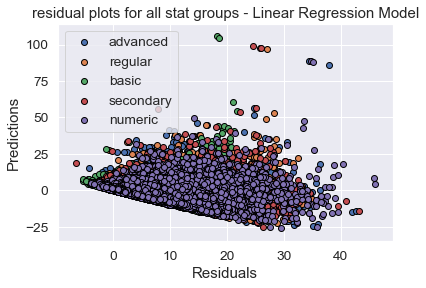

In [137]:
for k,v in dict_linear_regressions.items():
    plt.scatter(v['predictions_cv'], v['residuals'], edgecolors=(0, 0, 0), label=k)
plt.legend(loc='best')
plt.xlabel('Residuals')
plt.ylabel('Predictions')
plt.title('residual plots for all stat groups - Linear Regression Model'.format(k))
plt.show()

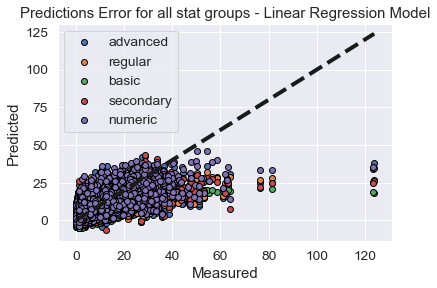

In [136]:
for k,v in dict_linear_regressions.items():
    plt.scatter(y, v['predictions_cv'], edgecolors=(0, 0, 0), label=k)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
plt.legend(loc='best')
plt.title('prediction error for all stat groups - Linear Regression Model')
plt.xlabel('Measured')
plt.ylabel('Predicted')
plt.show()

- [numeric] followed by [regular] stat groups scored 'best' -> highest r squared, and lowest rmse
- let's <b><u>use the [numeric] features group to identify over-valued, and under-valued players:</u></b>
    - <b><u><i>positive residual = overvalued, negative = undervalued</i></u></b>

##### Finding most undervalued vs most overvalued

In [ ]:
# add the residual based statistics into main DataFrame (df_stats)
# came up with two ways of measuring the residual: raw residual and also the normalised version of it residual% (of cap)
df_stats['lin_reg_predicted_%_of_cap'] = dict_linear_regressions['numeric']['predictions_cv']
df_stats['lin_reg_residuals'] = dict_linear_regressions['numeric']['residuals']
df_stats['lin_reg_residual%'] = df_stats['lin_reg_residuals']/df_stats['%_of_cap']*100

In [162]:
df_stats_copy = df_stats.copy()
imp_cols = ['season','name','age','team','per','%_of_cap','lin_reg_predicted_%_of_cap','lin_reg_residuals','lin_reg_residual%']
df_stats_copy = df_stats_copy[imp_cols]

sort_keys = ['lin_reg_residuals','lin_reg_residual%']
dict_50_top_bottom_rankings = {'top':
                                   {'residuals': {'lin_reg':pd.DataFrame()},
                                    'residual%': {'lin_reg':pd.DataFrame()}
                                   },
                               'bottom':
                                   {'residuals': {'lin_reg':pd.DataFrame()},
                                    'residual%': {'lin_reg':pd.DataFrame()}}}
for key in sort_keys:
    df_stats_copy.sort_values(key, inplace=True)
    if key == 'lin_reg_residuals':
        key__ = 'residuals'
    elif key == 'lin_reg_residual%':
        key__ = 'residual%'
    dict_50_top_bottom_rankings['top'][key__]['lin_reg'] =  df_stats_copy[:50]
    dict_50_top_bottom_rankings['bottom'][key__]['lin_reg'] = df_stats_copy[-50:]

    imp_cols_avgs = ['age','per','%_of_cap']
    print('-'*60)
    print('50 Most Undervalued by [{}]'.format(key__))
    for col in imp_cols_avgs:
        print('Average ' + col + ': ', dict_50_top_bottom_rankings['top'][key__]['lin_reg'][col].mean())
    print('Average absolute value residual: ', -1*dict_50_top_bottom_rankings['top'][key__]['lin_reg']['lin_reg_residuals'].mean(), '%')
    print()
    print_pandas_ds(dict_50_top_bottom_rankings['top'][key__]['lin_reg'].head(10))
    print()
    print('50 Most Overvalued by [{}]'.format(key__))
    for col in imp_cols_avgs:
        print('Average ' + col + ': ', dict_50_top_bottom_rankings['bottom'][key__]['lin_reg'][col].mean())
    print('Average absolute value residual: ', dict_50_top_bottom_rankings['bottom'][key__]['lin_reg']['lin_reg_residuals'].mean(), '%')
    print('-'*60)
    print_pandas_ds(dict_50_top_bottom_rankings['bottom'][key__]['lin_reg'].tail(10).sort_values(key, ascending=False))
    print()

------------------------------------------------------------
50 Most Undervalued by [residuals]
Average age:  28.12
Average per:  21.968000000000004
Average %_of_cap:  7.529892350645132
Average absolute value residual:  18.083249741653773 %



,season,name,age,team,per,%_of_cap,lin_reg_predicted_%_of_cap,lin_reg_residuals,lin_reg_residual%
4406,"2,003.00",Karl Malone,39.00,UTA,21.70,3.42,29.47,-26.05,-761.25
3987,"2,002.00",Michael Jordan,38.00,WAS,20.70,2.56,27.55,-24.99,-977.11
6122,"2,006.00",LeBron James,21.00,CLE,28.10,10.97,35.84,-24.87,-226.78
11048,"2,015.00",Anthony Davis,21.00,NOP,30.80,10.10,32.30,-22.20,-219.73
11494,"2,015.00",Pau Gasol,34.00,CHI,22.70,10.64,32.34,-21.70,-203.92
11598,"2,015.00",Tim Duncan,38.00,SAS,22.60,7.14,28.29,-21.15,-296.04
5563,"2,005.00",LeBron James,20.00,CLE,25.70,9.34,29.94,-20.61,-220.70
3278,"2,001.00",Dirk Nowitzki,22.00,DAL,22.80,5.08,25.57,-20.49,-403.71
12551,"2,017.00",Karl-Anthony Towns,21.00,MIN,26.00,6.27,26.65,-20.38,-324.77
3639,"2,001.00",Vince Carter,24.00,TOR,25.00,7.23,27.43,-20.20,-279.40



50 Most Overvalued by [residuals]
Average age:  29.74
Average per:  16.409999999999997
Average %_of_cap:  47.59841579673616
Average absolute value residual:  30.4899011320986 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,lin_reg_predicted_%_of_cap,lin_reg_residuals,lin_reg_residual%
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,34.79,88.93,71.88
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,35.17,88.02,71.45
4424,"2,003.00",Kevin Garnett,26.00,MIN,26.40,63.87,14.24,49.63,77.70
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,33.59,47.82,58.74
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,33.35,42.85,56.23
699,"1,996.00",Horace Grant,30.00,ORL,17.90,60.98,21.39,39.59,64.92
3922,"2,002.00",Juwan Howard,28.00,DAL,15.10,51.22,13.90,37.31,72.86
2895,"2,000.00",Juwan Howard,26.00,WAS,12.30,47.54,11.15,36.39,76.54
3935,"2,002.00",Kevin Garnett,25.00,MIN,23.80,62.58,27.11,35.47,56.68
1242,"1,997.00",Horace Grant,31.00,ORL,17.30,53.11,18.00,35.10,66.10



------------------------------------------------------------
50 Most Undervalued by [residual%]
Average age:  26.76
Average per:  9.759999999999998
Average %_of_cap:  0.11398146487697725
Average absolute value residual:  4.963543834765341 %



,season,name,age,team,per,%_of_cap,lin_reg_predicted_%_of_cap,lin_reg_residuals,lin_reg_residual%
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,6.34,-6.33,"-51,667.49"
11131,"2,015.00",Dahntay Jones,34.00,LAC,1.90,0.01,6.03,-6.02,"-47,756.93"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.11,-4.10,"-33,427.40"
12286,"2,017.00",Beno Udrih,34.00,DET,16.10,0.03,5.93,-5.91,"-23,414.90"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.20,-5.17,"-20,527.11"
11819,"2,016.00",Elijah Millsap,28.00,UTA,6.50,0.02,4.88,-4.85,"-19,805.94"
6092,"2,006.00",Kareem Rush,25.00,CHO,9.80,0.04,5.97,-5.94,"-16,206.15"
11839,"2,016.00",Gary Neal,31.00,WAS,13.50,0.08,7.39,-7.31,"-9,538.35"
11459,"2,015.00",Nate Robinson,30.00,DEN,10.60,0.06,5.71,-5.65,"-8,987.84"
1011,"1,997.00",Adrian Caldwell,30.00,BRK,5.10,0.07,6.53,-6.46,"-8,689.29"



50 Most Overvalued by [residual%]
Average age:  21.8
Average per:  10.824000000000002
Average %_of_cap:  1.436980093998263
Average absolute value residual:  2.6799322146607545 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,lin_reg_predicted_%_of_cap,lin_reg_residuals,lin_reg_residual%
10394,"2,014.00",A.J. Price,27.00,MIN,9.70,0.10,-2.55,2.65,"2,672.99"
12353,"2,017.00",Daniel Ochefu,23.00,WAS,6.60,0.05,-0.93,0.98,"1,937.98"
8701,"2,011.00",Ben Uzoh,22.00,BRK,14.70,0.11,-1.54,1.65,"1,554.43"
6137,"2,006.00",Luke Schenscher,23.00,CHI,9.30,0.10,-0.50,0.60,581.90
7910,"2,009.00",Othello Hunter,22.00,ATL,12.10,0.53,-2.20,2.73,512.27
5848,"2,006.00",Anthony Roberson,22.00,MEM,11.70,0.50,-1.92,2.43,482.56
9758,"2,012.00",Shelvin Mack,21.00,WAS,11.90,0.15,-0.49,0.64,416.25
8693,"2,011.00",Armon Johnson,21.00,POR,9.30,1.31,-3.85,5.16,393.21
11194,"2,015.00",Erick Green,23.00,DEN,8.90,0.14,-0.41,0.55,384.98
12786,"2,017.00",Treveon Graham,23.00,CHO,10.60,1.32,-3.39,4.71,355.93


- `residuals` measure seems to be biased against older 'superstar players' and young 'rookies' 
    - Comparing mean ages overvalued tends to have mean age > undervalue
    1. superstar players are expected to be paid a lot relative to other players, so they shouldn't be considered 'overvalued'
    2. rookies can't sign big contracts (their rookie contract doesn't take up much of the team's salary cap)
- `residual%` <b> is a better indicator of overvalue vs undervalue </b>
    - normalised version of residuals as a percent of the cap
    - results look more representative (avoids observations (1) and (2) above)
    - undervalue < mean age of overvalue (flipped relationship)

#### Team Implications?

In [682]:
#compute residuals by team-level and visualise compared to avg_wins
df_teams = df_stats_copy.groupby('team').mean()
df_teams['lin_reg_residual%'] = (df_teams['lin_reg_residuals']/df_teams['%_of_cap']) *100
df_teams = df_teams.drop('season', axis=1)

In [171]:
df_teams['avg_wins'] = df_team_wins['avg_wins'].tolist()

In [186]:
print_pandas_ds(df_teams.head())

,pos,age,gp,gs,per,ts%,3par,ftr,orb%,drb%,trb%,ast%,stl%,blk%,tov%,usg%,ows,dws,ws,ws/48,obpm,dbpm,bpm,vorp,fg%,3p%,2p%,efg%,ft%,mp_pg,orb_pg,drb_pg,trb_pg,ast_pg,stl_pg,blk_pg,tov_pg,pf_pg,pts_pg,fg_pg,fga_pg,3p_pg,3pa_pg,2p_pg,2pa_pg,ft_pg,fta_pg,gs/gp,credits,apx_value,seasons_left,trade_value,versatility,cap,%_of_cap,lin_reg_predicted_%_of_cap,lin_reg_residuals,lin_reg_residual%,avg_wins
team,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ATL,2.97,26.75,58.44,31.67,13.63,0.52,0.21,0.30,5.64,13.95,9.81,13.52,1.67,1.45,14.16,19.20,1.60,1.53,3.12,0.09,-0.98,-0.33,-1.30,0.76,0.45,0.27,0.47,0.48,0.74,23.39,1.11,2.90,4.01,2.04,0.75,0.47,1.39,2.00,9.33,3.50,7.80,0.62,1.74,2.88,6.06,1.72,2.28,0.48,5.13,4.01,6.93,47.34,3.92,"52,276,702.21",8.69,9.33,-0.64,-7.33,38.22
BOS,3.03,26.33,57.50,29.88,13.40,0.52,0.22,0.30,5.70,14.47,10.07,13.78,1.78,1.53,14.38,18.56,1.51,1.65,3.16,0.09,-1.05,0.19,-0.85,0.79,0.45,0.25,0.47,0.48,0.73,22.75,1.05,2.83,3.88,2.12,0.81,0.41,1.36,2.18,9.13,3.41,7.58,0.62,1.78,2.79,5.80,1.69,2.24,0.46,5.18,3.33,7.25,31.14,3.90,"52,060,984.96",8.81,8.78,0.03,0.31,40.87
BRK,3.06,27.00,56.76,30.25,13.22,0.51,0.20,0.32,5.81,14.73,10.20,13.59,1.64,1.59,13.91,18.99,1.37,1.38,2.75,0.08,-1.32,-0.23,-1.55,0.61,0.43,0.25,0.45,0.47,0.73,23.31,1.16,2.92,4.09,2.07,0.74,0.46,1.36,2.11,9.25,3.42,7.80,0.57,1.66,2.85,6.14,1.83,2.44,0.49,5.02,3.34,6.75,33.04,3.87,"52,097,127.34",9.26,9.08,0.18,1.98,33.83
CHI,3.03,27.02,59.18,29.72,13.41,0.51,0.19,0.29,6.00,14.32,10.16,14.58,1.62,1.52,14.31,19.05,1.43,1.83,3.26,0.09,-1.12,0.28,-0.84,0.83,0.44,0.25,0.46,0.47,0.73,23.10,1.19,2.95,4.14,2.17,0.72,0.45,1.37,2.04,9.22,3.50,7.89,0.55,1.52,2.95,6.37,1.68,2.23,0.47,5.22,3.94,6.73,40.93,4.04,"51,564,303.37",9.47,10.01,-0.54,-5.73,40.83
CHO,3.02,26.51,52.82,25.26,12.94,0.52,0.25,0.31,5.00,15.12,9.98,12.29,1.44,1.65,12.24,18.74,1.00,1.38,2.38,0.08,-1.53,-0.18,-1.71,0.45,0.44,0.27,0.46,0.48,0.75,21.59,0.88,2.85,3.73,1.75,0.61,0.43,1.09,1.80,8.43,3.12,7.15,0.67,1.93,2.44,5.22,1.52,2.00,0.41,4.71,2.56,7.12,13.50,3.49,"69,412,231.58",6.88,7.43,-0.55,-7.95,36.05


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


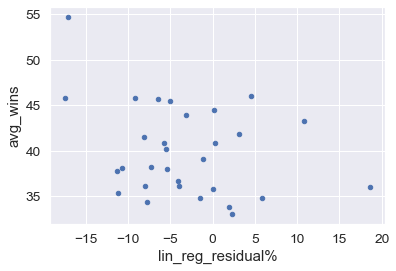

In [174]:
scatter_lr = df_teams.plot.scatter('lin_reg_residual%', 'avg_wins')

<b>Recall that this analysis was just for the `numeric` feature group, so below we repeat the process for the other statistic groups</b>

--------------------------------------------------------------------------------
[advanced] Number of Teams avg_wins >= 50% with Positive Residual%: 5
[advanced] Number of Teams avg_wins >= 50% with Negative Residual%: 6
[advanced] Conclusion: Teams that undervalue their players win more on average
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
[regular] Number of Teams avg_wins >= 50% with Positive Residual%: 7
[regular] Number of Teams avg_wins >= 50% with Negative Residual%: 4
[regular] Conclusion: Teams that overvalue their players win more on average
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
[basic] Number of Teams avg_wins >= 50% with Positive Residual%: 8
[basic] Number of Teams avg_wins >= 50% with Negative Residual%: 3
[basic] Conclusion: Teams

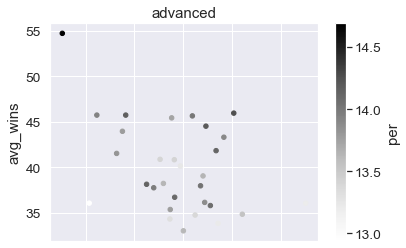

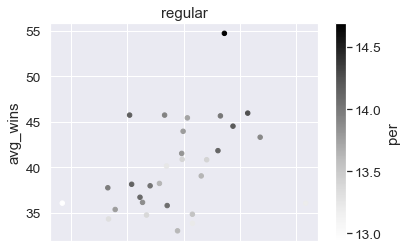

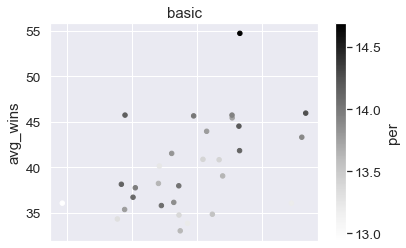

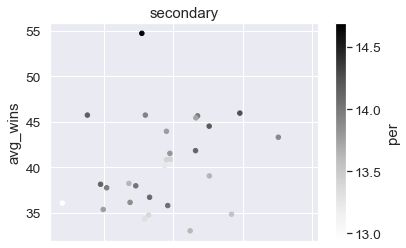

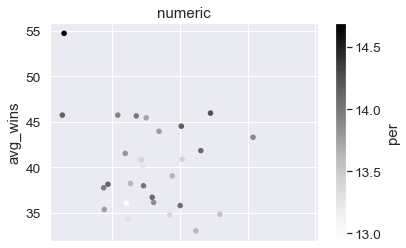

In [223]:
for group in stat_groups.keys():
    df_stats['lin_reg_predicted_%_of_cap'] = dict_linear_regressions[group]['predictions_cv']
    df_stats['lin_reg_residuals'] = dict_linear_regressions[group]['residuals']
    df_stats['lin_reg_residual%'] = df_stats['lin_reg_residuals']/df_stats['%_of_cap']*100

    df_stats_copy = df_stats.copy()

    df_teams = df_stats_copy.groupby('team').mean()
    df_teams['lin_reg_residual%'] = (df_teams['lin_reg_residuals']/df_teams['%_of_cap']) *100
    df_teams = df_teams.drop('season', axis=1)

    df_teams['avg_wins'] = df_team_wins['avg_wins'].tolist()
    
    df_teams.plot.scatter('lin_reg_residual%', 'avg_wins', c=4, title=group)
    
    mask_50pct_wins = df_teams['avg_wins'] >= 41
    mask_pos_res = df_teams[mask_50pct_wins]['lin_reg_residual%'] > 0
    mask_neg_res = df_teams[mask_50pct_wins]['lin_reg_residual%'] < 0
    count_overvalue = len(df_teams[mask_50pct_wins][mask_pos_res])
    count_undervalue = len(df_teams[mask_50pct_wins][mask_neg_res])
    print('-'*80)
    print("[{}] Number of Teams avg_wins >= 50% with Positive Residual%: {}".format(group, count_overvalue))
    print("[{}] Number of Teams avg_wins >= 50% with Negative Residual%: {}".format(group, count_undervalue))
    if count_overvalue > count_undervalue:
        suggested_outcome = 'Teams that overvalue their players win more on average'
    elif count_overvalue < count_undervalue:
        suggested_outcome = 'Teams that undervalue their players win more on average'
    else:
        suggested_outcome = "Overvaluing vs Undervaluing players suggest no change on team wins "
    print("[{}] Conclusion: {}".format(group, suggested_outcome))
    print('-'*80)
    print()

    [advanced] Conclusion: Teams that undervalue their players win more on average
    [regular] Conclusion: Teams that overvalue their players win more on average
    [basic] Conclusion: Teams that overvalue their players win more on average
    [secondary] Conclusion: Teams that overvalue their players win more on average
    [numeric] Conclusion: Teams that undervalue their players win more on average
    
    ['Best' Model Result - Linear Regression]
    [numeric] Root Mean Squared Error [y_test cross-val]: 5.63627929575788
    [numeric] R squared [y_test cross-val]: 0.5472675243511308 (+/- 0.04449386267548558)

<b>Results change depending on feature group! <br>
Two 'strongest' results `numeric` and `regular` feature groups have conflicting conclusions!

## Other Linear Models (Ridge, Lasso, ElasticNet, SGDRegressor, Lars)

In [418]:
linear_models = {'Ridge': Ridge(),
                 'Lasso': Lasso(),
                 'ElasticNet': ElasticNet(),
                 'SGDRegressor': SGDRegressor(),
                 'Lars': Lars(),
                }
params_linear_models = {
    'Ridge': {'alpha': np.logspace(-4, 1, 6),
              'normalize': [True, False],
              'tol': np.arange( 0.001, 0.01+0.001, 0.001).tolist(),
              'random_state': [0]
             },
    'Lasso': {'alpha': np.logspace(-4, 1, 6),
              'normalize': [True, False],
              'tol': [1],
              'random_state': [0]
             },
    'ElasticNet': {'alpha': np.logspace(-4, 1, 6),
                   'normalize': [True, False],
                   'tol': [1],
                   'random_state': [0]
                   },
    'SGDRegressor': {'alpha': np.logspace(-4, 1, 6),
                     'tol': [1],
                     'random_state': [0],
           },
    'Lars': {'n_nonzero_coefs': np.arange(10, 500, 5),
             'normalize': [True, False],
            },
}

X_train, X_test, y_train, y_test = train_test_split(df_stats[col_groups['num']], y, test_size=0.2, random_state=0)

linear_model_selector = EstimatorSelectionHelper(linear_models, params_linear_models)
linear_model_selector.fit(X_train, y_train, cv=5, n_jobs=-1)

Running GridSearchCV for Ridge.
Running GridSearchCV for Lasso.
Running GridSearchCV for ElasticNet.
Running GridSearchCV for SGDRegressor.
Running GridSearchCV for Lars.
Done.


In [419]:
df_linear_models_scores = linear_model_selector.score_summary()

In [420]:
df_best_linear_models = df_linear_models_scores.groupby('estimator')[['mean_test_score','std_test_score','params']].max().sort_values(by='mean_test_score', ascending=False)
print_pandas_ds(df_best_linear_models)

,mean_test_score,std_test_score
estimator,,
Ridge,0.55,0.02
Lars,0.52,"212,573,688,312,014,340,096.00"
ElasticNet,0.50,0.02
Lasso,0.49,0.02
SGDRegressor,"-5,785,974,780,442,669,126,450,924,706,721,603,...","5,216,729,183,642,759,891,592,118,814,567,882,9..."


<b>Ridge model has higher mean_test_score (R Squared) and lower std compared to Linear Model</b>

In [590]:
#rebuild the models based on grid search
dict_linear_models_best_scores = df_best_linear_models.to_dict()

records = []
for key in dict_linear_models_best_scores['mean_test_score'].keys():
    target_mean_test_score = dict_linear_models_best_scores['mean_test_score'][key]
    records.append(df_linear_models_scores.query('mean_test_score == @target_mean_test_score & estimator == @key'))

dict_best_linear_models = {'Ridge':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                           'Lasso':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                           'ElasticNet':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                           'Lars':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                           'SGDRegressor':dict.fromkeys(['model','predictions','predictions_dv','residuals'])
                          }

for rec in records:
    r = rec.to_numpy()
    update_key = r[0][0]
    params = r[0][5]
    print_pandas_ds("Rebuilding: {}.".format(update_key))
    if update_key == 'Ridge':
        model = Ridge(alpha= params['alpha'], normalize= params['normalize'], random_state=params['random_state'], tol= params['tol'])
    elif update_key == 'Lars':
        model = Lars(n_nonzero_coefs= 15, normalize= params['normalize'])
    elif update_key == 'Lasso':
        model = Lasso(alpha= params['alpha'], normalize= params['normalize'], random_state= params['random_state'], tol= params['tol'])
    elif update_key == 'ElasticNet':
        model = ElasticNet(alpha= params['alpha'], normalize= params['normalize'], random_state= params['random_state'], tol= params['tol'])
    elif update_key == 'SGDRegressor':
        model = SGDRegressor(alpha= params['alpha'], random_state= params['random_state'], tol= params['tol'])
        
    model.fit(X_train, y_train)
    predictions_model = model.predict(X_test)
    predictions_model_cv = cross_val_predict(model, df_stats[col_groups['num']], y, cv=3, n_jobs=-1)
    tmp_dict = {update_key : {'model': model,
                              'predictions': predictions_model, 
                              'predictions_cv': predictions_model_cv,
                              'residuals': y - predictions_model_cv}}
    dict_best_linear_models.update(tmp_dict)
print("Complete.")

'Rebuilding: Ridge.'

'Rebuilding: Lars.'

'Rebuilding: ElasticNet.'

'Rebuilding: Lasso.'

'Rebuilding: SGDRegressor.'

Complete.


## Tree and Ensemble Models (DecisionTree, Bagging, RandomForest, GradientBoosting)

In [425]:
tree_ensemble_models = {'DecisionTreeRegressor': DecisionTreeRegressor(),
                       'BaggingRegressor': BaggingRegressor(),
                       'RandomForestRegressor': RandomForestRegressor(),
                       'GradientBoostingRegressor': GradientBoostingRegressor()}

params_tree_ensemble_models = {'DecisionTreeRegressor': { 'max_depth': [None, 1, 2, 3, 4, 5, 10, 100, 150, 200, 250],
                                                         'random_state': [0]
                                                        },
                               'BaggingRegressor': {'n_estimators': [5, 10, 25],
                                                    'random_state': [0]
                                                   },
                               'RandomForestRegressor': {'n_estimators': [5, 50, 100, 150],
                                                         'max_features': ['auto', 'sqrt', 'log2'],
                                                         'max_depth': [None, 5, 10, 25], 
                                                         'min_samples_leaf': [1, 50, 100],
                                                         'random_state': [0]
                                                        },
                               'GradientBoostingRegressor': {'n_estimators': [5, 50, 100, 150],
                                                             'max_features': ['auto', 'sqrt', 'log2'],
                                                             'max_depth': [None, 5, 10, 25], 
                                                             'min_samples_leaf': [1, 50, 100],
                                                             'random_state': [0]
                                                            }}

tree_ensemble_model_selector = EstimatorSelectionHelper(tree_ensemble_models, params_tree_ensemble_models)
tree_ensemble_model_selector.fit(X_train, y_train, cv=3, n_jobs=-1)

Running GridSearchCV for DecisionTreeRegressor.
Running GridSearchCV for BaggingRegressor.
Running GridSearchCV for RandomForestRegressor.
Running GridSearchCV for GradientBoostingRegressor.
Done.


In [426]:
df_tree_ensemble_models_scores = tree_ensemble_model_selector.score_summary()

In [427]:
df_best_tree_ensemble_models = df_tree_ensemble_models_scores.groupby('estimator')[['mean_test_score','std_test_score','params']].max().sort_values(by='mean_test_score', ascending=False)
print_pandas_ds(df_best_tree_ensemble_models)

,mean_test_score,std_test_score
estimator,,
GradientBoostingRegressor,0.59,0.03
RandomForestRegressor,0.57,0.03
BaggingRegressor,0.55,0.02
DecisionTreeRegressor,0.48,0.06


<b>GradientBoostingRegressor model has higher mean_test_score (R Squared) and lower std compared to Linear and Ridge Model</b>

In [591]:
dict_tree_ensemble_models_best_scores = df_best_tree_ensemble_models.to_dict()

records = []
for key in dict_tree_ensemble_models_best_scores['mean_test_score'].keys():
    target_mean_test_score = dict_tree_ensemble_models_best_scores['mean_test_score'][key]
    records.append(df_tree_ensemble_models_scores.query('mean_test_score == @target_mean_test_score & estimator == @key'))

dict_best_tree_ensemble_models = {'BaggingRegressor':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                                  'DecisionTreeRegressor':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                                  'GradientBoostingRegressor':dict.fromkeys(['model','predictions','predictions_dv','residuals']),
                                  'RandomForestRegressor':dict.fromkeys(['model','predictions','predictions_dv','residuals'])}

for rec in records:
    r = rec.to_numpy()
    print_pandas_ds("Rebuilding: {}.".format(r[0][0]))
    update_key = r[0][0]
    params = r[0][5]
    if update_key == 'BaggingRegressor':
        model = BaggingRegressor(n_estimators=params['n_estimators'], random_state=params['random_state'])
    elif update_key == 'DecisionTreeRegressor':
        model = DecisionTreeRegressor(max_depth=params['max_depth'], random_state=params['random_state'])
    elif update_key == 'GradientBoostingRegressor':
        model = GradientBoostingRegressor(max_depth=params['max_depth'],max_features=params['max_features'],min_samples_leaf=params['min_samples_leaf'],n_estimators=params['n_estimators'],random_state=params['random_state'])
    elif update_key == 'RandomForestRegressor':
        model = RandomForestRegressor(max_depth=params['max_depth'],max_features=params['max_features'],min_samples_leaf=params['min_samples_leaf'],n_estimators=params['n_estimators'],random_state=params['random_state'])
    
    model.fit(X_train, y_train)
    predictions_model = model.predict(X_test)
    predictions_model_cv = cross_val_predict(model, df_stats[col_groups['num']], y, cv=3, n_jobs=-1)
    tmp_dict = {update_key : {'model': model,
                              'predictions': predictions_model, 
                              'predictions_cv': predictions_model_cv,
                              'residuals': y - predictions_model_cv}}
    dict_best_tree_ensemble_models.update(tmp_dict)
print("Complete.")

'Rebuilding: GradientBoostingRegressor.'

'Rebuilding: RandomForestRegressor.'

'Rebuilding: BaggingRegressor.'

'Rebuilding: DecisionTreeRegressor.'

Complete.


### Feature Selection (Ridge, Lasso, RandomForest)

[Ridge] Root Mean Squared Error [y_train]: 5.934529172680712
[Ridge] Root Mean Squared Error [y_test]: 5.470906641358158
[Ridge] R squared [X_train]: 0.5589394804856906
[Ridge] R squared [y_test]: 0.5759814602142501
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
[Ridge] Eliminated features:
[Ridge] picked 53 variables and eliminated 0 variables.


[]

[Lasso] Root Mean Squared Error [y_train]: 6.357161575263955
[Lasso] Root Mean Squared Error [y_test]: 5.918554032974696
[Lasso] R squared [X_train]: 0.493881577228504
[Lasso] R squared [y_test]: 0.5037534823676563
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
[Lasso] Eliminated features:
[Lasso] picked 39 variables and eliminated 14 variables.


['trb%',
 'ast%',
 'blk%',
 'dws',
 'obpm',
 'bpm',
 '3p%',
 'orb_pg',
 'trb_pg',
 '3p_pg',
 '3pa_pg',
 '2p_pg',
 '2pa_pg',
 'trade_value']

[ElasticNet] Root Mean Squared Error [y_train]: 6.28252736385943
[ElasticNet] Root Mean Squared Error [y_test]: 5.828441124254391
[ElasticNet] R squared [X_train]: 0.5056956592325338
[ElasticNet] R squared [y_test]: 0.5187496413707664
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
[ElasticNet] Eliminated features:
[ElasticNet] picked 50 variables and eliminated 3 variables.


['3p_pg', '2p_pg', 'trade_value']

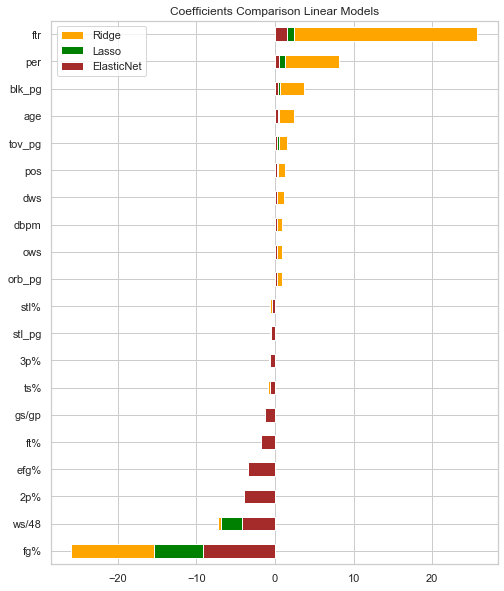

In [537]:
#Output feature importances:
for k,v in dict_best_linear_models.items():
    color_picker = {'Ridge': 'orange',
                    'Lasso': 'green',
                    'ElasticNet': 'brown'}
    if not k in color_picker.keys():
        continue
    model = v['model']
    
#     predict_y_train = cross_val_predict(model, X_train, y_train, cv=3, n_jobs=-1)

#     predict_xval_train = cross_val_predict(model, X_train, y_train, cv=3, n_jobs=-1)
#     predict_xval_test = cross_val_predict(model, X_test, y_test, cv=3, n_jobs=-1)
    
#     rmse_xval_y = np.sqrt(mean_squared_error(v['predictions_cv'], y))
#     rmse_xval_y_train = np.sqrt(mean_squared_error(predict_xval_train, y_train))
#     rmse_xval_y_test = np.sqrt(mean_squared_error(v['predictions'], y_test))
#     rmse_xval_y_train = np.sqrt(mean_squared_error(predict_xval_train, y_train))
#     rmse_xval_y_test = np.sqrt(mean_squared_error(predict_xval_test, y_test))
    
    
#     rmse_y = np.sqrt(mean_squared_error(v['predictions_cv'], y))
    rmse_y_test = np.sqrt(mean_squared_error(v['predictions'], y_test))
    rmse_y_train = np.sqrt(mean_squared_error(model.predict(X_train), y_train))

#     rmse_y_train = np.sqrt(mean_squared_error(predict_xval, y_train))
    
#     score_xval_train = cross_val_score(model, X_train, y_train, cv=3, n_jobs=-1)
#     score_xval_test = cross_val_score(model, X_test, y_test, cv=3, n_jobs=-1)
    
#     score_xval_train = model.score(X_train, y_train)
#     score_xval_test = cross_val_score(model, X_test, y_test, cv=3, n_jobs=-1)
    
#     score_y = r2_score(y, v['predictions_cv'])
    score_y_test = r2_score(y_test, v['predictions'])
    score_y_train = model.score(X_train,y_train)

#     print('[{}] Root Mean Squared Error [X_train cross-val]: {}'.format(k, rmse_xval_y_train))

#     print('[{}] Root Mean Squared Error [y cross-val]: {}'.format(k, rmse_y))
#     print('[{}] Root Mean Squared Error [y_train cross-val]: {}'.format(k, rmse_xval_y_train))
    print('[{}] Root Mean Squared Error [y_train]: {}'.format(k, rmse_y_train))

    print('[{}] Root Mean Squared Error [y_test]: {}'.format(k, rmse_y_test))
#     print('[{}] Root Mean Squared Error [y_test cross-val]: {}'.format(k, rmse_xval_y_test))

#     print('[{}] R squared [X_train cross-val]: {}'.format(k, score_xval_train))
#     print('[{}] R squared [y cross-val]: {}'.format(k, score_y))
#     print('[{}] R squared [y_train cross-val]: {} (+/- {})'.format(k, score_xval_train.mean(), score_xval_train.std()))
    print('[{}] R squared [X_train]: {}'.format(k, score_y_train))
    print('[{}] R squared [y_test]: {}'.format(k, score_y_test))


#     print('[{}] R squared [y_test cross-val]: {} (+/- {})'.format(k, score_xval_test.mean(), score_xval_test.std()))
    print('~'*80)

    coef = pd.Series(model.coef_, index= X_train.columns)
    imp_coef = pd.concat([coef.sort_values().head(10), coef.sort_values().tail(10)])

    plt.rcParams['figure.figsize'] = (8.0, 10.0)
    imp_coef.plot(kind = "barh", color=color_picker[k], label=k)

    print("[{}] Eliminated features:".format(k))
    print("[{}] picked {} variables and eliminated {} variables.".format(k, sum(coef != 0), sum(coef == 0)))
    print_pandas_ds(coef[coef == 0].index.tolist())
    print('='*80)
g = plt.title("Coefficients Comparison Linear Models".format(k))
feat_sel_legend = plt.legend()

Consistent model results (R square)<br>
Quite a few features could be eliminated from the `numeric` feature group according to lasso

--------------------------------------------------------------------------------
RandomForestRegressor Evaluation:
RandomForestRegressor Root Mean Squared Error: 6.058879715535079
RandomForestRegressor R squared: 0.5296012766366514
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
RandomForestRegressor Feature ranking:
1. mp_pg (0.21863239609911247)
2. versatility (0.13927902126790018)
3. per (0.06832995056075893)
4. age (0.06185785066247128)
5. fg_pg (0.0513705039244621)
6. blk_pg (0.02393131097858454)
7. pts_pg (0.020875725701275178)
8. 2p_pg (0.020136275242237257)
9. ws (0.01978685360075326)
10. gs/gp (0.01544491304358463)
11. pf_pg (0.014905811802657088)
12. drb_pg (0.014464328896798691)
13. cap (0.013966107814480919)
14. tov% (0.01375318118699816)
15. trade_value (0.012993934214030249)
16. tov_pg (0.012520109375071009)
17. trb_pg (0.011600195197150531)
18. 2pa_pg (0.011

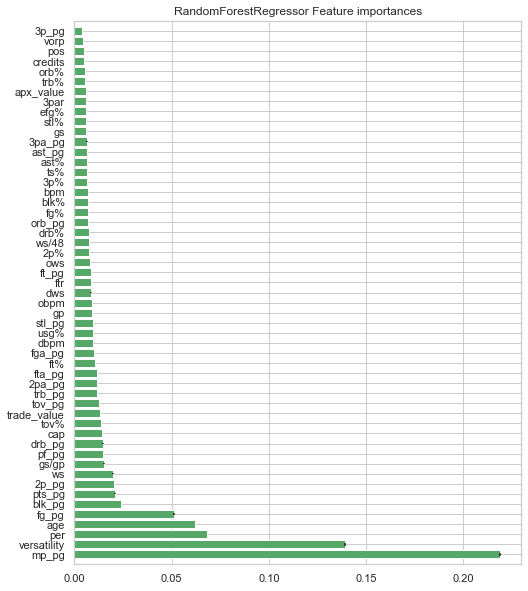

In [476]:
# #Random Forest
model = dict_best_tree_ensemble_models['RandomForestRegressor']['model']
v = dict_best_tree_ensemble_models['RandomForestRegressor']

predict_xval_test = cross_val_predict(model, X_test, y_test, cv=3, n_jobs=-1)

rmse_xval_y_test = np.sqrt(mean_squared_error(predict_xval_test, y_test))

score_xval_test = cross_val_score(model, X_test, y_test, cv=3, n_jobs=-1)

rmse_rf = np.sqrt(mean_squared_error(v['predictions_cv'], y))
score_rf = r2_score(y, v['predictions_cv'])


print('-'*80)
print("RandomForestRegressor Evaluation:")
# print('RandomForestRegressor Root Mean Squared Error [y cross-val]: {}'.format(rmse_rf))
# print('RandomForestRegressor R squared [y cross-val]: {}'.format(score_rf))
print('RandomForestRegressor Root Mean Squared Error [y-test cross-val]: {}'.format(rmse_rf))
print('RandomForestRegressor R squared [y-test cross-val]: {}'.format(score_rf))
print('-'*80)
print()
importances = model.feature_importances_
std = np.std([tree.feature_importances_ for tree in model.estimators_], axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print('-'*80)
print("RandomForestRegressor Feature ranking:")

rf_feat_imp_ticks = []
for f in range(X_test.shape[1]):
    rf_feat_imp_ticks.append(X_test.columns[indices[f]])
    print("{}. {} ({})".format(f + 1, X_test.columns[indices[f]], importances[indices[f]]))
print('-'*80)

# Plot the feature importances of the forest
plt.figure()
plt.title("RandomForestRegressor Feature importances")
plt.barh(range(X_test.shape[1]), importances[indices],
       color="g", yerr=std[indices], align="center")
plt.yticks(range(X_test.shape[1]), rf_feat_imp_ticks)
plt.ylim([-1, X_test.shape[1]])
plt.show()

- Also consistent R-square
- 4 out of the 5 highest variable importances were also present in the 10 top heatmap in the EDA section
    - Including the feature engineered `versatility` rating!!
    1. mp_pg (0.21863239609911247)
    2. versatility (0.13927902126790018)
    <strike>3. per (0.06832995056075893)</strike>
    4. age (0.06185785066247128)
    5. fg_pg (0.0513705039244621)

### Visualise Trees

DecisionTreeRegressor(criterion='mse', max_depth=5, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=0, splitter='best')


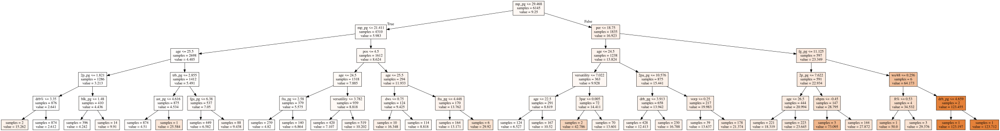

In [547]:
#decision tree
print(dict_best_tree_ensemble_models['DecisionTreeRegressor']['model'])
export_graphviz(dict_best_tree_ensemble_models['DecisionTreeRegressor']['model'], out_file="decision_tree.dot",
                feature_names=stat_groups['numeric'].columns, impurity=False, filled=True)
with open("decision_tree.dot") as f:
    dot_graph = f.read()
Source(dot_graph)

In [558]:
#bagged tree
print(dict_best_tree_ensemble_models['BaggingRegressor']['model'])
bagged_tree = dict_best_tree_ensemble_models['BaggingRegressor']['model']
export_graphviz(bagged_tree.estimators_[0], out_file="one_from_bagged_tree.dot",feature_names=stat_groups['numeric'].columns, impurity=False, filled=True)
with open("one_from_bagged_tree.dot") as f:
    dot_graph = f.read()
Source(dot_graph)

BaggingRegressor(base_estimator=None, bootstrap=True, bootstrap_features=False,
                 max_features=1.0, max_samples=1.0, n_estimators=25,
                 n_jobs=None, oob_score=False, random_state=0, verbose=0,
                 warm_start=False)


In [559]:
#random forest tree
print(dict_best_tree_ensemble_models['RandomForestRegressor']['model'])
rf = dict_best_tree_ensemble_models['RandomForestRegressor']['model']
export_graphviz(rf.estimators_[0], out_file="one_from_rf.dot",feature_names=stat_groups['numeric'].columns, impurity=False, filled=True)
with open("one_from_rf.dot") as f:
    dot_graph = f.read()
Source(dot_graph)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=150,
                      n_jobs=None, oob_score=False, random_state=0, verbose=0,
                      warm_start=False)


GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.1, loss='ls', max_depth=5,
                          max_features='log2', max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=150,
                          n_iter_no_change=None, presort='auto', random_state=0,
                          subsample=1.0, tol=0.0001, validation_fraction=0.1,
                          verbose=0, warm_start=False)


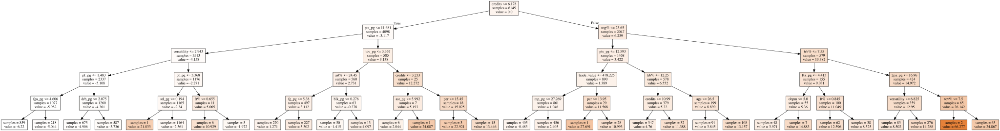

In [569]:
#gradient boosting tree
print(dict_best_tree_ensemble_models['GradientBoostingRegressor']['model'])
gb = dict_best_tree_ensemble_models['GradientBoostingRegressor']['model']
export_graphviz(gb.estimators_[0][0], out_file="one_from_gb.dot",feature_names=stat_groups['numeric'].columns, impurity=False, filled=True)
with open("one_from_gb.dot") as f:
    dot_graph = f.read()
Source(dot_graph)

In [664]:
rmse_y_test = np.sqrt(mean_squared_error(dict_best_tree_ensemble_models['GradientBoostingRegressor']['predictions'], y_test))
rmse_y_train = np.sqrt(mean_squared_error(model.predict(X_train), y_train))

score_y_test = r2_score(y_test, dict_best_tree_ensemble_models['GradientBoostingRegressor']['predictions'])
score_y_train = model.score(X_train,y_train)

print('[{}] Root Mean Squared Error [y_train]: {}'.format('GradientBoostingRegressor', rmse_y_train))
print('[{}] Root Mean Squared Error [y_test]: {}'.format('GradientBoostingRegressor', rmse_y_test))

print('[{}] R squared [X_train]: {}'.format('GradientBoostingRegressor', score_y_train))
print('[{}] R squared [y_test]: {}'.format('GradientBoostingRegressor', score_y_test))

[GradientBoostingRegressor] Root Mean Squared Error [y_train]: 5.719533080230635
[GradientBoostingRegressor] Root Mean Squared Error [y_test]: 5.276153271926613
[GradientBoostingRegressor] R squared [X_train]: 0.5903180793191842
[GradientBoostingRegressor] R squared [y_test]: 0.6056325656189327


## Residual Analysis (Other Linear, Trees, and Ensemble Models)

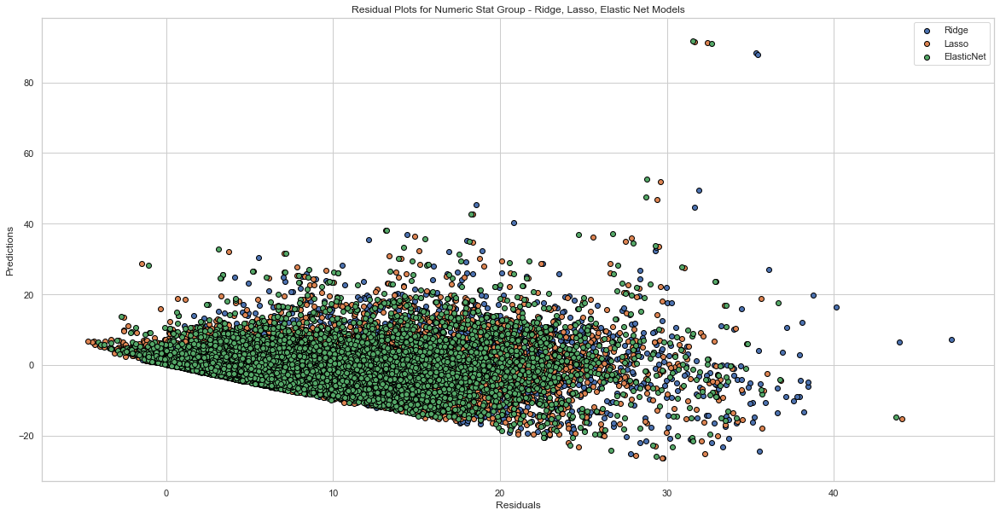

In [595]:
for k,v in dict_best_linear_models.items():
    if k != 'Ridge' and k != 'Lasso' and k != 'ElasticNet':
        continue
    tmp = dict_best_linear_models[k]
    plt.scatter(tmp['predictions_cv'], tmp['residuals'], edgecolors=(0, 0, 0), label=k)
plt.legend(loc='best')
plt.xlabel('Residuals')
plt.ylabel('Predictions')
plt.title('Residual Plots for Numeric Stat Group - Ridge, Lasso, Elastic Net Models'.format(k))
plt.show()

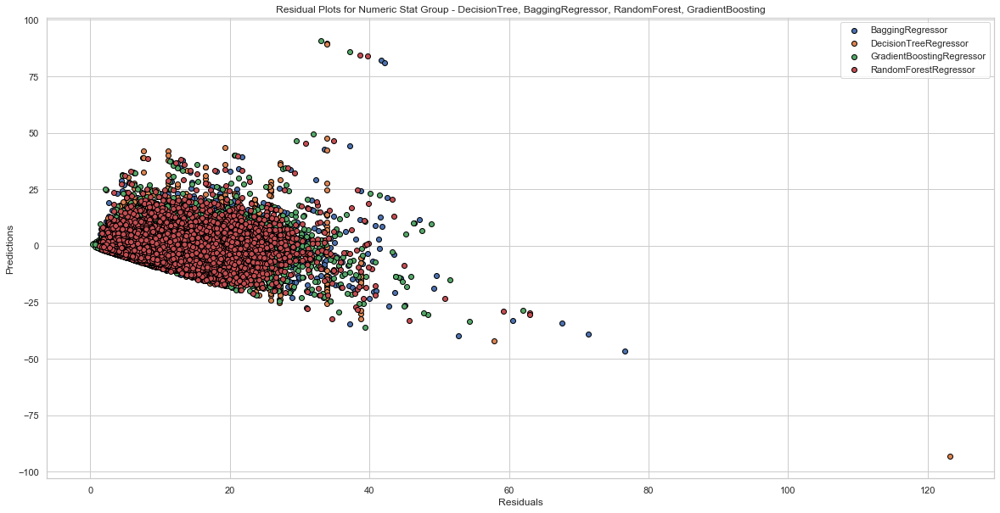

In [597]:
for k,v in dict_best_tree_ensemble_models.items():
    tmp = dict_best_tree_ensemble_models[k]
    plt.scatter(tmp['predictions_cv'], tmp['residuals'], edgecolors=(0, 0, 0), label=k)
plt.legend(loc='best')
plt.xlabel('Residuals')
plt.ylabel('Predictions')
plt.title('Residual Plots for Numeric Stat Group - DecisionTree, BaggingRegressor, RandomForest, GradientBoosting'.format(k))
plt.show()

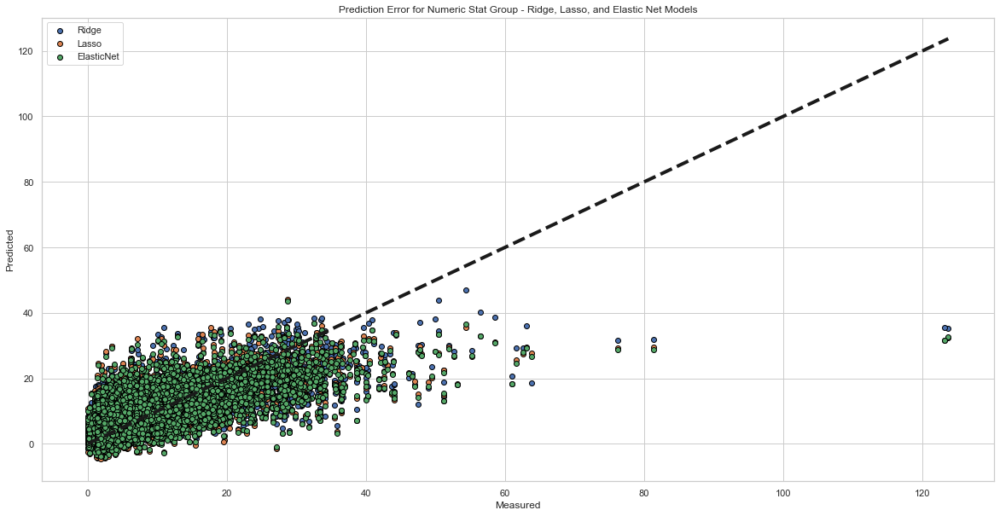

In [599]:
for k,v in dict_best_linear_models.items():
    if k != 'Ridge' and k != 'Lasso' and k != 'ElasticNet':
        continue
    tmp = dict_best_linear_models[k]
    plt.scatter(y, v['predictions_cv'], edgecolors=(0, 0, 0), label=k)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
plt.legend(loc='best')
plt.title('Prediction Error for Numeric Stat Group - Ridge, Lasso, and Elastic Net Models')
plt.xlabel('Measured')
plt.ylabel('Predicted')
plt.show()

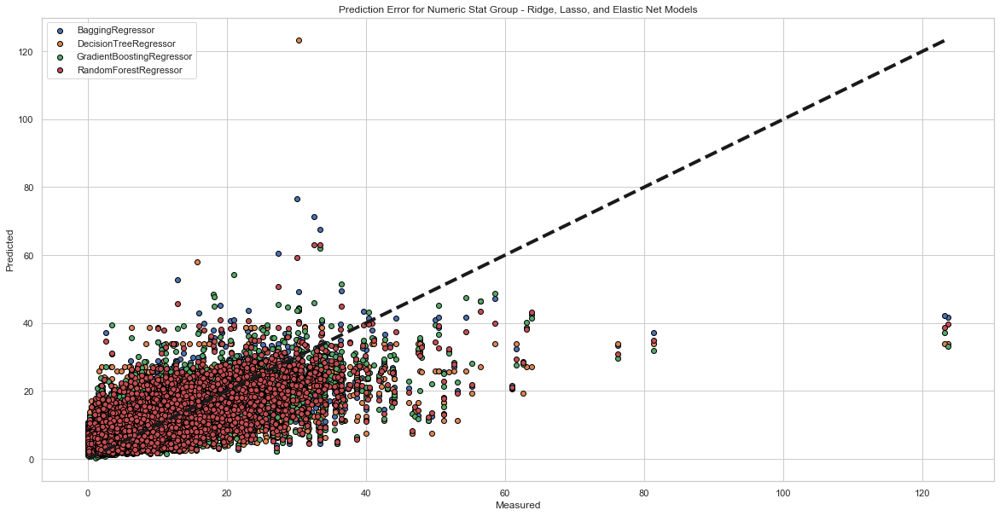

In [601]:
for k,v in dict_best_tree_ensemble_models.items():
    tmp = dict_best_tree_ensemble_models[k]
    plt.scatter(y, tmp['predictions_cv'], edgecolors=(0, 0, 0), label=k)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
plt.legend(loc='best')
plt.title('Prediction Error for Numeric Stat Group - Ridge, Lasso, and Elastic Net Models')
plt.xlabel('Measured')
plt.ylabel('Predicted')
plt.show()

#### Residual Analysis

In [628]:
for k,v in dict_best_linear_models.items():
    if k != 'Ridge' and k != 'Lasso' and k != 'ElasticNet':
        continue
    tmp = dict_best_linear_models[k]
    df_stats[k+'_predicted_%_of_cap'] = dict_best_linear_models[k]['predictions_cv']
    df_stats[k+'_residuals'] = dict_best_linear_models[k]['residuals']
    df_stats[k+'_residual%'] = df_stats[k+'_residuals']/df_stats['%_of_cap']*100
    

In [628]:
    
df_stats_copy = df_stats.copy()
imp_cols = ['season','name','age','team','per','%_of_cap',
            'Ridge_predicted_%_of_cap','Ridge_residuals','Ridge_residual%',
            'Lasso_predicted_%_of_cap','Lasso_residuals','Lasso_residual%',
            'ElasticNet_predicted_%_of_cap','ElasticNet_residuals','ElasticNet_residual%']

df_stats_copy = df_stats_copy[imp_cols]

sort_keys = ['Ridge_residuals','Ridge_residual%',
             'Lasso_residuals','Lasso_residual%',
             'ElasticNet_residuals','ElasticNet_residual%']
sort_keys2 =  ['_residuals','_residual%']
dict_50_top_bottom_rankings2 = {'top':
                                   {'residuals': {'Ridge_residuals':pd.DataFrame(),
                                                 'Lasso_residuals':pd.DataFrame(),
                                                 'ElasticNet_residuals':pd.DataFrame()},
                                    'residual%': {'Ridge_residual%':pd.DataFrame(),
                                                 'Lasso_residual%':pd.DataFrame(),
                                                 'ElasticNet_residual%':pd.DataFrame()}
                                   },
                               'bottom':
                                   {'residuals': {'Ridge_residuals':pd.DataFrame(),
                                                 'Lasso_residuals':pd.DataFrame(),
                                                 'ElasticNet_residuals':pd.DataFrame()},
                                    'residual%': {'Ridge_residual%':pd.DataFrame(),
                                                 'Lasso_residual%':pd.DataFrame(),
                                                 'ElasticNet_residual%':pd.DataFrame()}
                                   }
                               }

res_pct_keys = [e for e in sort_keys if '%' in e]
res_keys = [e for e in sort_keys if not '%' in e]


for k,v in dict_best_linear_models.items():
    if k != 'Ridge' and k != 'Lasso' and k != 'ElasticNet':
        continue
    for key1 in sort_keys2:
        key = k + key1
        df_stats_copy.sort_values(key, inplace=True)
        if key in res_keys:
            key__ = 'residuals'
        elif key in res_pct_keys:
            key__ = 'residual%'                       
        dict_50_top_bottom_rankings2['top'][key__][key] =  df_stats_copy[:50]
        dict_50_top_bottom_rankings2['bottom'][key__][key] = df_stats_copy[-50:]
        imp_cols_avgs = ['age','per','%_of_cap']
        print('-'*60)
        print('50 Most Undervalued by [sorted by: {}]'.format(key))
        for col in imp_cols_avgs:
            print('Average ' + col + ': ', dict_50_top_bottom_rankings2['top'][key__][key][col].mean())
        print('Average absolute value residual: ', -1*dict_50_top_bottom_rankings2['top'][key__][key][key].mean(), '%')
        print()
        print_pandas_ds(dict_50_top_bottom_rankings2['top'][key__][key].head(5))
        print()
        print('50 Most Overvalued by [sorted by: {}]'.format(key))
        for col in imp_cols_avgs:
            print('Average ' + col + ': ', dict_50_top_bottom_rankings2['bottom'][key__][key][col].mean())
        print('Average absolute value residual: ', dict_50_top_bottom_rankings2['bottom'][key__][key][key].mean(), '%')
        print('-'*60)
        print_pandas_ds(dict_50_top_bottom_rankings2['bottom'][key__][key].tail(5).sort_values(key, ascending=False))
        print()

------------------------------------------------------------
50 Most Undervalued by [sorted by: Ridge_residuals]
Average age:  27.34
Average per:  21.956000000000003
Average %_of_cap:  6.972874375504062
Average absolute value residual:  18.404820505172985 %



,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
4406,"2,003.00",Karl Malone,39.00,UTA,21.70,3.42,29.74,-26.32,-769.27,29.72,-26.30,-768.66,29.34,-25.92,-757.60
3987,"2,002.00",Michael Jordan,38.00,WAS,20.70,2.56,27.83,-25.27,-988.08,28.14,-25.58,"-1,000.32",26.66,-24.10,-942.41
6122,"2,006.00",LeBron James,21.00,CLE,28.10,10.97,35.51,-24.54,-223.73,29.98,-19.01,-173.29,31.49,-20.52,-187.09
11048,"2,015.00",Anthony Davis,21.00,NOP,30.80,10.10,33.34,-23.24,-230.08,31.47,-21.37,-211.60,31.55,-21.45,-212.36
12551,"2,017.00",Karl-Anthony Towns,21.00,MIN,26.00,6.27,28.39,-22.11,-352.48,29.28,-23.00,-366.66,29.13,-22.85,-364.25



50 Most Overvalued by [sorted by: Ridge_residuals]
Average age:  29.74
Average per:  16.409999999999997
Average %_of_cap:  47.59841579673616
Average absolute value residual:  30.231765190534325 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,35.32,88.39,71.45,32.42,91.29,73.80,32.68,91.03,73.58
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,35.43,87.76,71.24,31.64,91.56,74.32,31.55,91.64,74.39
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,31.89,49.52,60.83,29.62,51.79,63.61,28.78,52.63,64.65
4424,"2,003.00",Kevin Garnett,26.00,MIN,26.40,63.87,18.59,45.28,70.90,27.84,36.03,56.41,26.75,37.12,58.11
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,31.65,44.56,58.47,29.38,46.83,61.44,28.71,47.50,62.33



------------------------------------------------------------
50 Most Undervalued by [sorted by: Ridge_residual%]
Average age:  26.9
Average per:  9.760000000000002
Average %_of_cap:  0.10841273813813462
Average absolute value residual:  8517.474863904576 %



,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,6.48,-6.46,"-52,758.76",1.34,-1.33,"-10,850.26",2.13,-2.12,"-17,285.70"
11131,"2,015.00",Dahntay Jones,34.00,LAC,1.90,0.01,6.23,-6.22,"-49,383.30",0.36,-0.35,"-2,741.47",0.61,-0.59,"-4,703.52"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.50,-4.49,"-36,619.80",2.53,-2.52,"-20,541.25",2.82,-2.81,"-22,919.03"
12286,"2,017.00",Beno Udrih,34.00,DET,16.10,0.03,7.04,-7.01,"-27,804.07",10.67,-10.64,"-42,173.23",9.90,-9.87,"-39,123.64"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.67,-5.64,"-22,398.19",7.91,-7.88,"-31,286.11",7.81,-7.79,"-30,909.33"



50 Most Overvalued by [sorted by: Ridge_residual%]
Average age:  21.9
Average per:  11.172000000000002
Average %_of_cap:  1.7644236703251477
Average absolute value residual:  259.2958563390238 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
12353,"2,017.00",Daniel Ochefu,23.00,WAS,6.60,0.05,-1.43,1.48,"2,942.69",0.59,-0.54,"-1,064.66",1.58,-1.53,"-3,033.28"
8701,"2,011.00",Ben Uzoh,22.00,BRK,14.70,0.11,-1.11,1.22,"1,152.36",3.84,-3.73,"-3,528.66",4.14,-4.04,"-3,815.19"
10394,"2,014.00",A.J. Price,27.00,MIN,9.70,0.10,-0.58,0.68,687.86,4.74,-4.64,"-4,681.71",4.63,-4.53,"-4,563.72"
5848,"2,006.00",Anthony Roberson,22.00,MEM,11.70,0.50,-2.00,2.50,497.04,-0.71,1.21,240.27,-0.53,1.03,205.70
7910,"2,009.00",Othello Hunter,22.00,ATL,12.10,0.53,-1.42,1.95,365.74,0.09,0.44,82.80,0.36,0.17,32.64



------------------------------------------------------------
50 Most Undervalued by [sorted by: Lasso_residuals]
Average age:  27.84
Average per:  22.59
Average %_of_cap:  7.361658721007903
Average absolute value residual:  18.21887655306041 %



,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
4406,"2,003.00",Karl Malone,39.00,UTA,21.70,3.42,29.74,-26.32,-769.27,29.72,-26.30,-768.66,29.34,-25.92,-757.60
3987,"2,002.00",Michael Jordan,38.00,WAS,20.70,2.56,27.83,-25.27,-988.08,28.14,-25.58,"-1,000.32",26.66,-24.10,-942.41
11598,"2,015.00",Tim Duncan,38.00,SAS,22.60,7.14,28.72,-21.58,-302.06,32.25,-25.11,-351.50,30.30,-23.16,-324.19
12664,"2,017.00",Nikola Jokic,21.00,DEN,26.40,1.48,20.57,-19.09,"-1,285.58",24.68,-23.20,"-1,562.22",24.17,-22.68,"-1,527.72"
12551,"2,017.00",Karl-Anthony Towns,21.00,MIN,26.00,6.27,28.39,-22.11,-352.48,29.28,-23.00,-366.66,29.13,-22.85,-364.25



50 Most Overvalued by [sorted by: Lasso_residuals]
Average age:  29.58
Average per:  16.839999999999993
Average %_of_cap:  48.342851285152804
Average absolute value residual:  31.837073341682984 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,35.43,87.76,71.24,31.64,91.56,74.32,31.55,91.64,74.39
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,35.32,88.39,71.45,32.42,91.29,73.80,32.68,91.03,73.58
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,31.89,49.52,60.83,29.62,51.79,63.61,28.78,52.63,64.65
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,31.65,44.56,58.47,29.38,46.83,61.44,28.71,47.50,62.33
699,"1,996.00",Horace Grant,30.00,ORL,17.90,60.98,20.79,40.19,65.91,18.35,42.63,69.90,18.25,42.73,70.07



------------------------------------------------------------
50 Most Undervalued by [sorted by: Lasso_residual%]
Average age:  27.12
Average per:  11.122
Average %_of_cap:  0.12841216909549147
Average absolute value residual:  6958.2523409569685 %



,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
12286,"2,017.00",Beno Udrih,34.00,DET,16.10,0.03,7.04,-7.01,"-27,804.07",10.67,-10.64,"-42,173.23",9.90,-9.87,"-39,123.64"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.67,-5.64,"-22,398.19",7.91,-7.88,"-31,286.11",7.81,-7.79,"-30,909.33"
11819,"2,016.00",Elijah Millsap,28.00,UTA,6.50,0.02,5.35,-5.32,"-21,718.16",5.38,-5.36,"-21,863.82",5.33,-5.31,"-21,667.93"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.50,-4.49,"-36,619.80",2.53,-2.52,"-20,541.25",2.82,-2.81,"-22,919.03"
6092,"2,006.00",Kareem Rush,25.00,CHO,9.80,0.04,5.98,-5.94,"-16,212.86",5.47,-5.44,"-14,839.83",5.41,-5.38,"-14,673.97"



50 Most Overvalued by [sorted by: Lasso_residual%]
Average age:  22.1
Average per:  6.248000000000001
Average %_of_cap:  1.1437384844905296
Average absolute value residual:  510.1724355859161 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
6352,"2,006.00",Von Wafer,20.00,LAL,-1.60,0.05,2.08,-2.04,"-4,458.21",-2.44,2.49,"5,440.40",-1.28,1.33,"2,899.81"
11699,"2,016.00",Axel Toupane,23.00,DEN,7.10,0.05,1.94,-1.89,"-3,455.22",-1.21,1.26,"2,305.53",-0.06,0.12,212.10
10636,"2,014.00",Jamaal Franklin,22.00,MEM,4.70,0.26,1.43,-1.18,-454.14,-3.12,3.38,"1,303.66",-2.79,3.05,"1,179.37"
6137,"2,006.00",Luke Schenscher,23.00,CHI,9.30,0.10,-0.24,0.35,334.98,-0.93,1.04,"1,003.22",-0.79,0.90,867.12
10869,"2,014.00",Peyton Siva,23.00,DET,5.70,0.16,2.57,-2.42,"-1,523.27",-1.04,1.20,756.35,-0.52,0.68,428.81



------------------------------------------------------------
50 Most Undervalued by [sorted by: ElasticNet_residuals]
Average age:  26.54
Average per:  22.819999999999997
Average %_of_cap:  7.189689065640206
Average absolute value residual:  17.891138185434325 %



,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
4406,"2,003.00",Karl Malone,39.00,UTA,21.70,3.42,29.74,-26.32,-769.27,29.72,-26.30,-768.66,29.34,-25.92,-757.60
3987,"2,002.00",Michael Jordan,38.00,WAS,20.70,2.56,27.83,-25.27,-988.08,28.14,-25.58,"-1,000.32",26.66,-24.10,-942.41
11598,"2,015.00",Tim Duncan,38.00,SAS,22.60,7.14,28.72,-21.58,-302.06,32.25,-25.11,-351.50,30.30,-23.16,-324.19
12551,"2,017.00",Karl-Anthony Towns,21.00,MIN,26.00,6.27,28.39,-22.11,-352.48,29.28,-23.00,-366.66,29.13,-22.85,-364.25
12664,"2,017.00",Nikola Jokic,21.00,DEN,26.40,1.48,20.57,-19.09,"-1,285.58",24.68,-23.20,"-1,562.22",24.17,-22.68,"-1,527.72"



50 Most Overvalued by [sorted by: ElasticNet_residuals]
Average age:  29.54
Average per:  17.05999999999999
Average %_of_cap:  48.45088193772961
Average absolute value residual:  31.888442778261215 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,35.43,87.76,71.24,31.64,91.56,74.32,31.55,91.64,74.39
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,35.32,88.39,71.45,32.42,91.29,73.80,32.68,91.03,73.58
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,31.89,49.52,60.83,29.62,51.79,63.61,28.78,52.63,64.65
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,31.65,44.56,58.47,29.38,46.83,61.44,28.71,47.50,62.33
699,"1,996.00",Horace Grant,30.00,ORL,17.90,60.98,20.79,40.19,65.91,18.35,42.63,69.90,18.25,42.73,70.07



------------------------------------------------------------
50 Most Undervalued by [sorted by: ElasticNet_residual%]
Average age:  27.0
Average per:  11.015999999999995
Average %_of_cap:  0.1221618703984658
Average absolute value residual:  6991.7079526435655 %



,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
12286,"2,017.00",Beno Udrih,34.00,DET,16.10,0.03,7.04,-7.01,"-27,804.07",10.67,-10.64,"-42,173.23",9.90,-9.87,"-39,123.64"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.67,-5.64,"-22,398.19",7.91,-7.88,"-31,286.11",7.81,-7.79,"-30,909.33"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.50,-4.49,"-36,619.80",2.53,-2.52,"-20,541.25",2.82,-2.81,"-22,919.03"
11819,"2,016.00",Elijah Millsap,28.00,UTA,6.50,0.02,5.35,-5.32,"-21,718.16",5.38,-5.36,"-21,863.82",5.33,-5.31,"-21,667.93"
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,6.48,-6.46,"-52,758.76",1.34,-1.33,"-10,850.26",2.13,-2.12,"-17,285.70"



50 Most Overvalued by [sorted by: ElasticNet_residual%]
Average age:  22.1
Average per:  5.8580000000000005
Average %_of_cap:  1.1783885833033427
Average absolute value residual:  365.07918587446954 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,Ridge_predicted_%_of_cap,Ridge_residuals,Ridge_residual%,Lasso_predicted_%_of_cap,Lasso_residuals,Lasso_residual%,ElasticNet_predicted_%_of_cap,ElasticNet_residuals,ElasticNet_residual%
6352,"2,006.00",Von Wafer,20.00,LAL,-1.60,0.05,2.08,-2.04,"-4,458.21",-2.44,2.49,"5,440.40",-1.28,1.33,"2,899.81"
10636,"2,014.00",Jamaal Franklin,22.00,MEM,4.70,0.26,1.43,-1.18,-454.14,-3.12,3.38,"1,303.66",-2.79,3.05,"1,179.37"
6137,"2,006.00",Luke Schenscher,23.00,CHI,9.30,0.10,-0.24,0.35,334.98,-0.93,1.04,"1,003.22",-0.79,0.90,867.12
12007,"2,016.00",Lamar Patterson,24.00,ATL,5.10,0.14,3.34,-3.20,"-2,345.30",-0.83,0.97,709.26,-0.86,1.00,731.80
9613,"2,012.00",Lazar Hayward,25.00,OKC,3.10,0.14,4.06,-3.92,"-2,827.85",-0.91,1.05,755.28,-0.84,0.98,705.26


<b>SAME PATTERNS FOUND</b>
- `residuals` measure seems to be biased against older 'superstar players' and young 'rookies' 
    - Comparing mean ages overvalued tends to have mean age > undervalue
    1. superstar players are expected to be paid a lot relative to other players, so they shouldn't be considered 'overvalued'
    2. rookies can't sign big contracts (their rookie contract doesn't take up much of the team's salary cap)
- `residual%` <b> is a better indicator of overvalue vs undervalue </b>
    - normalised version of residuals as a percent of the cap
    - results look more representative (avoids observations (1) and (2) above)
    - undervalue < mean age of overvalue (flipped relationship)

- `residual%` is a better indicator of overvalue vs undervalue <b> regardless of linear model applied</b>
    - sorting by `residual` of any linear model still showed bias against 'superstar players' and 'rookies'
    - sorting by `residual%` removed this bias and <b><u>similar players showed up between models</u></b>

--------------------------------------------------------------------------------
[Ridge] Number of Teams avg_wins >= 50% with Positive Residual%: 3
[Ridge] Number of Teams avg_wins >= 50% with Negative Residual%: 8
[Ridge] Conclusion: Teams that undervalue their players win more on average
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
[Lasso] Number of Teams avg_wins >= 50% with Positive Residual%: 3
[Lasso] Number of Teams avg_wins >= 50% with Negative Residual%: 8
[Lasso] Conclusion: Teams that undervalue their players win more on average
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
[ElasticNet] Number of Teams avg_wins >= 50% with Positive Residual%: 3
[ElasticNet] Number of Teams avg_wins >= 50% with Negative Residual%: 8
[ElasticNet] Conclusion: Team

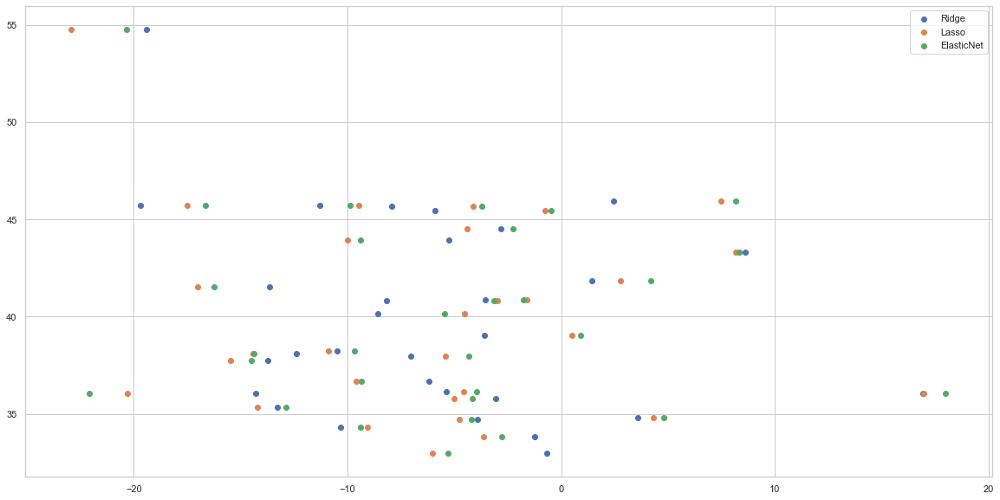

In [652]:
for k,v in dict_best_linear_models.items():
    if k != 'Ridge' and k != 'Lasso' and k != 'ElasticNet':
        continue

    df_stats_copy = df_stats.copy()

    df_teams = df_stats_copy.groupby('team').mean()
    df_teams[k+'_residual%'] = (df_teams[k+'_residuals']/df_teams['%_of_cap'])*100
    df_teams = df_teams.drop('season', axis=1)

    df_teams['avg_wins'] = df_team_wins['avg_wins'].tolist()
    
    plt.scatter(df_teams[k+'_residual%'], df_teams['avg_wins'], label=k)
    
    mask_50pct_wins = df_teams['avg_wins'] >= 41
#     print(k+'_residual%')
    mask_pos_res = df_teams[mask_50pct_wins][k+'_residual%'] > 0
    mask_neg_res = df_teams[mask_50pct_wins][k+'_residual%'] < 0
#     print_pandas_ds(df_teams[mask_50pct_wins][mask_pos_res].head(10))

    count_overvalue = len(df_teams[mask_50pct_wins][mask_pos_res])
    count_undervalue = len(df_teams[mask_50pct_wins][mask_neg_res])
    print('-'*80)
    print("[{}] Number of Teams avg_wins >= 50% with Positive Residual%: {}".format(k, count_overvalue))
    print("[{}] Number of Teams avg_wins >= 50% with Negative Residual%: {}".format(k, count_undervalue))
    if count_overvalue > count_undervalue:
        suggested_outcome = 'Teams that overvalue their players win more on average'
    elif count_overvalue < count_undervalue:
        suggested_outcome = 'Teams that undervalue their players win more on average'
    else:
        suggested_outcome = "Overvaluing vs Undervaluing players suggest no change on team wins "
    print("[{}] Conclusion: {}".format(k, suggested_outcome))
    print('-'*80)
    print()
    
# g1 = plt.scatter(df_teams['Ridge_residual%'], df_teams['avg_wins'], label='Ridge')
# g2 = plt.scatter(df_teams['Lasso_residual%'], df_teams['avg_wins'], label='Lasso')
# g3 = plt.scatter(df_teams['ElasticNet_residual%'], df_teams['avg_wins'], label='ElasticNet')
g123_legend = plt.legend(loc="best")

    [Ridge] Conclusion: Teams that undervalue their players win more on average
    [Lasso] Conclusion: Teams that undervalue their players win more on average
    [ElasticNet] Conclusion: Teams that undervalue their players win more on average
    
    ['Best' Model Result - Ridge Regression]
    [Ridge] Root Mean Squared Error [y_train]: 5.934529172680712
    [Ridge] Root Mean Squared Error [y_test]: 5.470906641358158
    [Ridge] R squared [X_train]: 0.5589394804856906
    [Ridge] R squared [y_test]: 0.5759814602142501
    
    [Compared to Linear Model]
    [numeric] Root Mean Squared Error [y_test cross-val]: 5.63627929575788
    [numeric] R squared [y_test cross-val]: 0.5472675243511308 (+/- 0.04449386267548558)
    

In [656]:
for k,v in dict_best_tree_ensemble_models.items():
    tmp = dict_best_tree_ensemble_models[k]
    df_stats[k+'_predicted_%_of_cap'] = dict_best_tree_ensemble_models[k]['predictions_cv']
    df_stats[k+'_residuals'] = dict_best_tree_ensemble_models[k]['residuals']
    df_stats[k+'_residual%'] = df_stats[k+'_residuals']/df_stats['%_of_cap']*100
    

In [657]:
dict_best_tree_ensemble_models.keys()

dict_keys(['BaggingRegressor', 'DecisionTreeRegressor', 'GradientBoostingRegressor', 'RandomForestRegressor'])

In [661]:
df_stats_copy = df_stats.copy()
imp_cols = ['season','name','age','team','per','%_of_cap',
            'BaggingRegressor_predicted_%_of_cap', 'DecisionTreeRegressor_predicted_%_of_cap', 
            'GradientBoostingRegressor_predicted_%_of_cap', 'RandomForestRegressor_predicted_%_of_cap',
            'BaggingRegressor_residuals', 'DecisionTreeRegressor_residuals', 
            'GradientBoostingRegressor_residuals', 'RandomForestRegressor_residuals',
            'BaggingRegressor_residual%', 'DecisionTreeRegressor_residual%', 
            'GradientBoostingRegressor_residual%', 'RandomForestRegressor_residual%',]

df_stats_copy = df_stats_copy[imp_cols]

sort_keys = ['BaggingRegressor_residuals', 'DecisionTreeRegressor_residuals', 
             'GradientBoostingRegressor_residuals', 'RandomForestRegressor_residuals',
             'BaggingRegressor_residual%', 'DecisionTreeRegressor_residual%', 
             'GradientBoostingRegressor_residual%', 'RandomForestRegressor_residual%',]
sort_keys2 =  ['_residuals','_residual%']
dict_50_top_bottom_rankings2 = {'top':
                                   {'residuals': {'BaggingRegressor_residuals': pd.DataFrame(),
                                                  'DecisionTreeRegressor_residuals': pd.DataFrame(),
                                                  'GradientBoostingRegressor_residuals': pd.DataFrame(),
                                                  'RandomForestRegressor_residuals': pd.DataFrame(),},
                                    'residual%': {'BaggingRegressor_residual%': pd.DataFrame(),
                                                  'DecisionTreeRegressor_residual%': pd.DataFrame(),
                                                  'GradientBoostingRegressor_residual%': pd.DataFrame(),
                                                  'RandomForestRegressor_residual%': pd.DataFrame(),}
                                   },
                               'bottom':
                                   {'residuals': {'BaggingRegressor_residuals': pd.DataFrame(),
                                                  'DecisionTreeRegressor_residuals': pd.DataFrame(),
                                                  'GradientBoostingRegressor_residuals': pd.DataFrame(),
                                                  'RandomForestRegressor_residuals': pd.DataFrame(),},
                                    'residual%': {'BaggingRegressor_residual%': pd.DataFrame(),
                                                  'DecisionTreeRegressor_residual%': pd.DataFrame(),
                                                  'GradientBoostingRegressor_residual%': pd.DataFrame(),
                                                  'RandomForestRegressor_residual%': pd.DataFrame(),}
                                   }
                               }

res_pct_keys = [e for e in sort_keys if '%' in e]
res_keys = [e for e in sort_keys if not '%' in e]


for k,v in dict_best_tree_ensemble_models.items():
    for key1 in sort_keys2:
        key = k + key1
        df_stats_copy.sort_values(key, inplace=True)
        if key in res_keys:
            key__ = 'residuals'
        elif key in res_pct_keys:
            key__ = 'residual%'                       
        dict_50_top_bottom_rankings2['top'][key__][key] =  df_stats_copy[:50]
        dict_50_top_bottom_rankings2['bottom'][key__][key] = df_stats_copy[-50:]
        imp_cols_avgs = ['age','per','%_of_cap']
        print('-'*60)
        print('50 Most Undervalued by [sorted by: {}]'.format(key))
        for col in imp_cols_avgs:
            print('Average ' + col + ': ', dict_50_top_bottom_rankings2['top'][key__][key][col].mean())
        print('Average absolute value residual: ', -1*dict_50_top_bottom_rankings2['top'][key__][key][key].mean(), '%')
        print()
        print_pandas_ds(dict_50_top_bottom_rankings2['top'][key__][key].head(5))
        print()
        print('50 Most Overvalued by [sorted by: {}]'.format(key))
        for col in imp_cols_avgs:
            print('Average ' + col + ': ', dict_50_top_bottom_rankings2['bottom'][key__][key][col].mean())
        print('Average absolute value residual: ', dict_50_top_bottom_rankings2['bottom'][key__][key][key].mean(), '%')
        print('-'*60)
        print_pandas_ds(dict_50_top_bottom_rankings2['bottom'][key__][key].tail(5).sort_values(key, ascending=False))
        print()

------------------------------------------------------------
50 Most Undervalued by [sorted by: BaggingRegressor_residuals]
Average age:  28.36
Average per:  23.173999999999992
Average %_of_cap:  12.084533694463117
Average absolute value residual:  21.504390138862455 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
10738,"2,014.00",Kevin Durant,25.00,OKC,29.80,30.12,76.64,25.60,43.70,59.17,-46.52,4.53,-13.58,-29.04,-154.43,15.02,-45.10,-96.43
12170,"2,016.00",Stephen Curry,27.00,GSW,31.50,12.87,52.75,25.60,38.50,45.76,-39.88,-12.73,-25.63,-32.90,-309.99,-98.94,-199.22,-255.68
10186,"2,013.00",LeBron James,28.00,MIA,31.60,32.49,71.41,25.60,45.92,62.98,-38.92,6.90,-13.42,-30.49,-119.77,21.23,-41.30,-93.83
3987,"2,002.00",Michael Jordan,38.00,WAS,20.70,2.56,37.23,23.53,27.05,34.67,-34.68,-20.98,-24.49,-32.12,"-1,355.74",-820.15,-957.64,"-1,255.66"
6111,"2,006.00",Kobe Bryant,27.00,LAL,28.00,33.35,67.65,28.79,61.96,62.97,-34.30,4.56,-28.61,-29.62,-102.86,13.67,-85.81,-88.83



50 Most Overvalued by [sorted by: BaggingRegressor_residuals]
Average age:  29.12
Average per:  16.727999999999994
Average %_of_cap:  47.17359654486964
Average absolute value residual:  30.287006090381897 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,41.73,33.96,33.09,39.75,81.98,89.76,90.63,83.97,66.27,72.55,73.26,67.87
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,42.22,33.96,37.24,38.66,80.97,89.24,85.96,84.53,65.73,72.44,69.78,68.62
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,37.14,33.96,31.91,34.91,44.27,47.45,49.50,46.50,54.37,58.29,60.80,57.12
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,33.51,33.96,29.58,30.82,42.69,42.25,46.63,45.39,56.02,55.44,61.19,59.56
699,"1,996.00",Horace Grant,30.00,ORL,17.90,60.98,21.70,20.70,20.80,21.14,39.28,40.29,40.18,39.84,64.42,66.06,65.89,65.33



------------------------------------------------------------
50 Most Undervalued by [sorted by: BaggingRegressor_residual%]
Average age:  27.12
Average per:  9.996
Average %_of_cap:  0.11820375146529967
Average absolute value residual:  8671.202045396767 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,4.95,3.92,5.09,4.67,-4.94,-3.91,-5.08,-4.65,"-40,341.36","-31,894.45","-41,440.89","-37,981.81"
11131,"2,015.00",Dahntay Jones,34.00,LAC,1.90,0.01,4.66,4.06,3.34,5.70,-4.64,-4.05,-3.32,-5.69,"-36,865.80","-32,140.91","-26,382.15","-45,179.94"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.10,3.92,3.65,3.89,-4.09,-3.91,-3.64,-3.88,"-33,371.27","-31,894.45","-29,716.92","-31,631.68"
6092,"2,006.00",Kareem Rush,25.00,CHO,9.80,0.04,10.33,6.29,6.40,7.63,-10.30,-6.25,-6.36,-7.59,"-28,108.58","-17,068.28","-17,358.98","-20,724.18"
11819,"2,016.00",Elijah Millsap,28.00,UTA,6.50,0.02,5.97,4.06,5.15,4.80,-5.95,-4.04,-5.13,-4.77,"-24,282.47","-16,476.31","-20,928.43","-19,469.69"



50 Most Overvalued by [sorted by: BaggingRegressor_residual%]
Average age:  27.16
Average per:  11.684000000000001
Average %_of_cap:  21.02484633132315
Average absolute value residual:  78.89516355096201 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
7345,"2,008.00",Raef LaFrentz,31.00,POR,10.40,21.68,2.64,4.22,3.90,3.32,19.04,17.46,17.78,18.36,87.81,80.54,81.99,84.69
9465,"2,012.00",Gilbert Arenas,30.00,MEM,9.90,35.85,4.53,5.37,4.62,4.89,31.32,30.48,31.23,30.96,87.36,85.02,87.12,86.36
4659,"2,004.00",Anfernee Hardaway,32.00,PHO,13.20,33.34,4.44,9.06,7.13,5.69,28.90,24.28,26.20,27.65,86.68,72.84,78.60,82.94
11097,"2,015.00",Cameron Bairstow,24.00,CHI,2.10,27.14,3.89,2.26,2.17,3.38,23.25,24.88,24.97,23.77,85.66,91.68,92.00,87.56
5254,"2,005.00",Anfernee Hardaway,33.00,NYK,9.00,31.82,4.80,6.29,6.74,4.51,27.02,25.53,25.08,27.31,84.92,80.23,78.81,85.82



------------------------------------------------------------
50 Most Undervalued by [sorted by: DecisionTreeRegressor_residuals]
Average age:  26.04
Average per:  20.70000000000001
Average %_of_cap:  8.376722928924812
Average absolute value residual:  22.309230048541636 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
4610,"2,003.00",Tracy McGrady,23.00,ORL,30.30,30.29,44.45,123.20,43.73,40.31,-14.15,-92.91,-13.44,-10.02,-46.73,-306.71,-44.38,-33.08
7635,"2,009.00",David West,28.00,NOP,18.90,15.73,24.86,57.90,27.37,24.99,-9.13,-42.17,-11.64,-9.26,-58.06,-268.13,-74.02,-58.89
11969,"2,016.00",Karl-Anthony Towns,20.00,MIN,22.50,6.33,16.89,38.79,14.84,19.37,-10.56,-32.46,-8.50,-13.04,-166.83,-512.72,-134.33,-205.96
10435,"2,014.00",Anthony Davis,20.00,NOP,26.50,8.89,21.41,38.79,16.92,21.66,-12.52,-29.90,-8.03,-12.77,-140.80,-336.29,-90.35,-143.63
11048,"2,015.00",Anthony Davis,21.00,NOP,30.80,10.10,34.37,38.79,34.44,38.34,-24.27,-28.69,-24.34,-28.23,-240.27,-284.03,-240.98,-279.52



50 Most Overvalued by [sorted by: DecisionTreeRegressor_residuals]
Average age:  29.7
Average per:  18.629999999999992
Average %_of_cap:  49.45032293034225
Average absolute value residual:  32.923182346913926 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,41.73,33.96,33.09,39.75,81.98,89.76,90.63,83.97,66.27,72.55,73.26,67.87
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,42.22,33.96,37.24,38.66,80.97,89.24,85.96,84.53,65.73,72.44,69.78,68.62
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,37.14,33.96,31.91,34.91,44.27,47.45,49.50,46.50,54.37,58.29,60.80,57.12
3935,"2,002.00",Kevin Garnett,25.00,MIN,23.80,62.58,28.68,19.25,27.94,28.27,33.90,43.33,34.63,34.31,54.17,69.24,55.35,54.83
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,33.51,33.96,29.58,30.82,42.69,42.25,46.63,45.39,56.02,55.44,61.19,59.56



------------------------------------------------------------
50 Most Undervalued by [sorted by: DecisionTreeRegressor_residual%]
Average age:  26.76
Average per:  9.804
Average %_of_cap:  0.1038524077169932
Average absolute value residual:  7762.986090541768 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
11131,"2,015.00",Dahntay Jones,34.00,LAC,1.90,0.01,4.66,4.06,3.34,5.70,-4.64,-4.05,-3.32,-5.69,"-36,865.80","-32,140.91","-26,382.15","-45,179.94"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.10,3.92,3.65,3.89,-4.09,-3.91,-3.64,-3.88,"-33,371.27","-31,894.45","-29,716.92","-31,631.68"
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,4.95,3.92,5.09,4.67,-4.94,-3.91,-5.08,-4.65,"-40,341.36","-31,894.45","-41,440.89","-37,981.81"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.82,5.37,6.51,5.44,-5.79,-5.34,-6.49,-5.42,"-22,993.48","-21,212.18","-25,744.50","-21,508.07"
12286,"2,017.00",Beno Udrih,34.00,DET,16.10,0.03,3.99,5.37,5.78,4.96,-3.96,-5.34,-5.75,-4.94,"-15,706.57","-21,184.20","-22,800.78","-19,563.90"



50 Most Overvalued by [sorted by: DecisionTreeRegressor_residual%]
Average age:  26.44
Average per:  13.424000000000001
Average %_of_cap:  23.520136441266132
Average absolute value residual:  79.45757544515635 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
11097,"2,015.00",Cameron Bairstow,24.00,CHI,2.10,27.14,3.89,2.26,2.17,3.38,23.25,24.88,24.97,23.77,85.66,91.68,92.00,87.56
9465,"2,012.00",Gilbert Arenas,30.00,MEM,9.90,35.85,4.53,5.37,4.62,4.89,31.32,30.48,31.23,30.96,87.36,85.02,87.12,86.36
2410,"1,999.00",Kevin Garnett,22.00,MIN,22.40,49.43,12.54,7.57,22.03,13.45,36.89,41.86,27.40,35.98,74.64,84.68,55.42,72.79
1900,"1,998.00",Kevin Garnett,21.00,MIN,20.40,46.67,7.54,7.57,13.23,8.22,39.13,39.09,33.44,38.44,83.85,83.77,71.65,82.38
5237,"2,005.00",Allan Houston,33.00,NYK,12.50,38.64,6.15,6.29,6.43,5.76,32.48,32.35,32.21,32.88,84.08,83.72,83.36,85.10



------------------------------------------------------------
50 Most Undervalued by [sorted by: GradientBoostingRegressor_residuals]
Average age:  28.98
Average per:  22.084
Average %_of_cap:  9.210530942130884
Average absolute value residual:  21.060731541989835 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
4406,"2,003.00",Karl Malone,39.00,UTA,21.70,3.42,30.94,21.43,39.40,31.10,-27.52,-18.01,-35.98,-27.68,-804.32,-526.47,"-1,051.55",-808.93
11150,"2,015.00",DeMarcus Cousins,24.00,SAC,25.20,21.04,40.98,38.79,54.30,39.50,-19.94,-17.75,-33.26,-18.46,-94.78,-84.36,-158.07,-87.71
11794,"2,016.00",DeMarcus Cousins,25.00,SAC,23.60,18.01,37.95,25.60,48.34,33.52,-19.94,-7.58,-30.33,-15.51,-110.68,-42.09,-168.39,-86.09
12377,"2,017.00",DeMarcus Cousins,26.00,NOP,23.30,18.23,32.48,25.60,47.74,31.63,-14.25,-7.37,-29.51,-13.40,-78.17,-40.41,-161.86,-73.50
12551,"2,017.00",Karl-Anthony Towns,21.00,MIN,26.00,6.27,26.02,25.60,35.54,24.69,-19.74,-19.32,-29.27,-18.42,-314.68,-307.97,-466.54,-293.62



50 Most Overvalued by [sorted by: GradientBoostingRegressor_residuals]
Average age:  29.72
Average per:  16.409999999999993
Average %_of_cap:  47.434531811929325
Average absolute value residual:  30.567813279586712 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,41.73,33.96,33.09,39.75,81.98,89.76,90.63,83.97,66.27,72.55,73.26,67.87
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,42.22,33.96,37.24,38.66,80.97,89.24,85.96,84.53,65.73,72.44,69.78,68.62
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,37.14,33.96,31.91,34.91,44.27,47.45,49.50,46.50,54.37,58.29,60.80,57.12
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,33.51,33.96,29.58,30.82,42.69,42.25,46.63,45.39,56.02,55.44,61.19,59.56
699,"1,996.00",Horace Grant,30.00,ORL,17.90,60.98,21.70,20.70,20.80,21.14,39.28,40.29,40.18,39.84,64.42,66.06,65.89,65.33



------------------------------------------------------------
50 Most Undervalued by [sorted by: GradientBoostingRegressor_residual%]
Average age:  27.04
Average per:  9.491999999999997
Average %_of_cap:  0.1156762385251896
Average absolute value residual:  7881.377297578113 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,4.95,3.92,5.09,4.67,-4.94,-3.91,-5.08,-4.65,"-40,341.36","-31,894.45","-41,440.89","-37,981.81"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.10,3.92,3.65,3.89,-4.09,-3.91,-3.64,-3.88,"-33,371.27","-31,894.45","-29,716.92","-31,631.68"
11131,"2,015.00",Dahntay Jones,34.00,LAC,1.90,0.01,4.66,4.06,3.34,5.70,-4.64,-4.05,-3.32,-5.69,"-36,865.80","-32,140.91","-26,382.15","-45,179.94"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.82,5.37,6.51,5.44,-5.79,-5.34,-6.49,-5.42,"-22,993.48","-21,212.18","-25,744.50","-21,508.07"
12286,"2,017.00",Beno Udrih,34.00,DET,16.10,0.03,3.99,5.37,5.78,4.96,-3.96,-5.34,-5.75,-4.94,"-15,706.57","-21,184.20","-22,800.78","-19,563.90"



50 Most Overvalued by [sorted by: GradientBoostingRegressor_residual%]
Average age:  29.02
Average per:  12.126000000000001
Average %_of_cap:  23.537855707198784
Average absolute value residual:  77.76577062641047 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
11097,"2,015.00",Cameron Bairstow,24.00,CHI,2.10,27.14,3.89,2.26,2.17,3.38,23.25,24.88,24.97,23.77,85.66,91.68,92.00,87.56
3765,"2,002.00",Danny Ferry,35.00,SAS,11.20,11.29,3.57,4.06,1.40,3.63,7.72,7.23,9.88,7.65,68.39,64.03,87.56,67.81
9465,"2,012.00",Gilbert Arenas,30.00,MEM,9.90,35.85,4.53,5.37,4.62,4.89,31.32,30.48,31.23,30.96,87.36,85.02,87.12,86.36
5237,"2,005.00",Allan Houston,33.00,NYK,12.50,38.64,6.15,6.29,6.43,5.76,32.48,32.35,32.21,32.88,84.08,83.72,83.36,85.10
5883,"2,006.00",Brian Grant,33.00,PHO,6.60,27.94,5.56,5.18,4.72,5.89,22.38,22.76,23.23,22.05,80.09,81.45,83.12,78.92



------------------------------------------------------------
50 Most Undervalued by [sorted by: RandomForestRegressor_residuals]
Average age:  29.06
Average per:  22.721999999999998
Average %_of_cap:  10.62641123352517
Average absolute value residual:  20.22335928914021 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
12170,"2,016.00",Stephen Curry,27.00,GSW,31.50,12.87,52.75,25.60,38.50,45.76,-39.88,-12.73,-25.63,-32.90,-309.99,-98.94,-199.22,-255.68
3987,"2,002.00",Michael Jordan,38.00,WAS,20.70,2.56,37.23,23.53,27.05,34.67,-34.68,-20.98,-24.49,-32.12,"-1,355.74",-820.15,-957.64,"-1,255.66"
10186,"2,013.00",LeBron James,28.00,MIA,31.60,32.49,71.41,25.60,45.92,62.98,-38.92,6.90,-13.42,-30.49,-119.77,21.23,-41.30,-93.83
6111,"2,006.00",Kobe Bryant,27.00,LAL,28.00,33.35,67.65,28.79,61.96,62.97,-34.30,4.56,-28.61,-29.62,-102.86,13.67,-85.81,-88.83
10738,"2,014.00",Kevin Durant,25.00,OKC,29.80,30.12,76.64,25.60,43.70,59.17,-46.52,4.53,-13.58,-29.04,-154.43,15.02,-45.10,-96.43



50 Most Overvalued by [sorted by: RandomForestRegressor_residuals]
Average age:  29.34
Average per:  16.263999999999992
Average %_of_cap:  46.55723257152681
Average absolute value residual:  30.768531180955666 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
1395,"1,997.00",Michael Jordan,33.00,CHI,27.80,123.20,42.22,33.96,37.24,38.66,80.97,89.24,85.96,84.53,65.73,72.44,69.78,68.62
824,"1,996.00",Michael Jordan,32.00,CHI,29.40,123.71,41.73,33.96,33.09,39.75,81.98,89.76,90.63,83.97,66.27,72.55,73.26,67.87
331,"1,995.00",Patrick Ewing,32.00,NYK,21.90,81.41,37.14,33.96,31.91,34.91,44.27,47.45,49.50,46.50,54.37,58.29,60.80,57.12
1415,"1,997.00",Patrick Ewing,34.00,NYK,21.30,76.21,33.51,33.96,29.58,30.82,42.69,42.25,46.63,45.39,56.02,55.44,61.19,59.56
699,"1,996.00",Horace Grant,30.00,ORL,17.90,60.98,21.70,20.70,20.80,21.14,39.28,40.29,40.18,39.84,64.42,66.06,65.89,65.33



------------------------------------------------------------
50 Most Undervalued by [sorted by: RandomForestRegressor_residual%]
Average age:  26.98
Average per:  9.72
Average %_of_cap:  0.11529736481679306
Average absolute value residual:  8394.449325423237 %



,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
11131,"2,015.00",Dahntay Jones,34.00,LAC,1.90,0.01,4.66,4.06,3.34,5.70,-4.64,-4.05,-3.32,-5.69,"-36,865.80","-32,140.91","-26,382.15","-45,179.94"
12094,"2,016.00",P.J. Hairston,23.00,MEM,5.70,0.01,4.95,3.92,5.09,4.67,-4.94,-3.91,-5.08,-4.65,"-40,341.36","-31,894.45","-41,440.89","-37,981.81"
12093,"2,016.00",P.J. Hairston,23.00,CHO,7.40,0.01,4.10,3.92,3.65,3.89,-4.09,-3.91,-3.64,-3.88,"-33,371.27","-31,894.45","-29,716.92","-31,631.68"
11166,"2,015.00",Dorell Wright,29.00,POR,13.40,0.03,5.82,5.37,6.51,5.44,-5.79,-5.34,-6.49,-5.42,"-22,993.48","-21,212.18","-25,744.50","-21,508.07"
6092,"2,006.00",Kareem Rush,25.00,CHO,9.80,0.04,10.33,6.29,6.40,7.63,-10.30,-6.25,-6.36,-7.59,"-28,108.58","-17,068.28","-17,358.98","-20,724.18"



50 Most Overvalued by [sorted by: RandomForestRegressor_residual%]
Average age:  26.76
Average per:  12.306000000000001
Average %_of_cap:  22.628085437778765
Average absolute value residual:  77.18949729441609 %
------------------------------------------------------------


,season,name,age,team,per,%_of_cap,BaggingRegressor_predicted_%_of_cap,DecisionTreeRegressor_predicted_%_of_cap,GradientBoostingRegressor_predicted_%_of_cap,RandomForestRegressor_predicted_%_of_cap,BaggingRegressor_residuals,DecisionTreeRegressor_residuals,GradientBoostingRegressor_residuals,RandomForestRegressor_residuals,BaggingRegressor_residual%,DecisionTreeRegressor_residual%,GradientBoostingRegressor_residual%,RandomForestRegressor_residual%
11097,"2,015.00",Cameron Bairstow,24.00,CHI,2.10,27.14,3.89,2.26,2.17,3.38,23.25,24.88,24.97,23.77,85.66,91.68,92.00,87.56
9465,"2,012.00",Gilbert Arenas,30.00,MEM,9.90,35.85,4.53,5.37,4.62,4.89,31.32,30.48,31.23,30.96,87.36,85.02,87.12,86.36
5254,"2,005.00",Anfernee Hardaway,33.00,NYK,9.00,31.82,4.80,6.29,6.74,4.51,27.02,25.53,25.08,27.31,84.92,80.23,78.81,85.82
5237,"2,005.00",Allan Houston,33.00,NYK,12.50,38.64,6.15,6.29,6.43,5.76,32.48,32.35,32.21,32.88,84.08,83.72,83.36,85.10
7345,"2,008.00",Raef LaFrentz,31.00,POR,10.40,21.68,2.64,4.22,3.90,3.32,19.04,17.46,17.78,18.36,87.81,80.54,81.99,84.69


- `residual%` <u> is still a better indicator of overvalue vs undervalue </u> <b> regardless of tree/ensemble model applied</b>
    - sorting by `residual` of any linear model still showed bias against 'superstar players' and 'rookies'
    - sorting by `residual%` removed this bias and <b>similar players showed up between models</b>

--------------------------------------------------------------------------------
[BaggingRegressor] Number of Teams avg_wins >= 50% with Positive Residual%: 3
[BaggingRegressor] Number of Teams avg_wins >= 50% with Negative Residual%: 8
[BaggingRegressor] Conclusion: Teams that undervalue their players win more on average
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
[DecisionTreeRegressor] Number of Teams avg_wins >= 50% with Positive Residual%: 4
[DecisionTreeRegressor] Number of Teams avg_wins >= 50% with Negative Residual%: 7
[DecisionTreeRegressor] Conclusion: Teams that undervalue their players win more on average
--------------------------------------------------------------------------------

--------------------------------------------------------------------------------
[GradientBoostingRegressor] Number of Teams avg_wins >= 50% with Positive Residual%: 2
[Grad

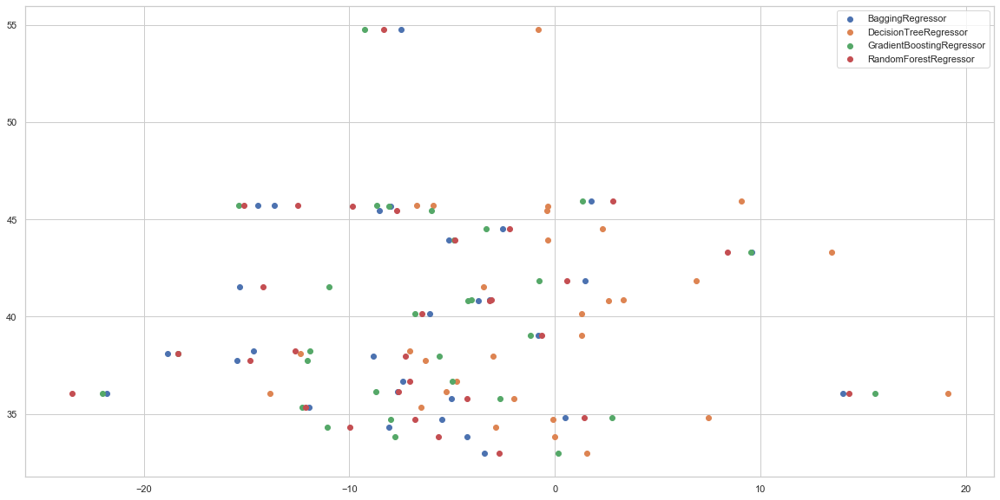

In [662]:
for k,v in dict_best_tree_ensemble_models.items():

    df_stats_copy = df_stats.copy()

    df_teams = df_stats_copy.groupby('team').mean()
    df_teams[k+'_residual%'] = (df_teams[k+'_residuals']/df_teams['%_of_cap'])*100
    df_teams = df_teams.drop('season', axis=1)

    df_teams['avg_wins'] = df_team_wins['avg_wins'].tolist()
    
    plt.scatter(df_teams[k+'_residual%'], df_teams['avg_wins'], label=k)
    
    mask_50pct_wins = df_teams['avg_wins'] >= 41
#     print(k+'_residual%')
    mask_pos_res = df_teams[mask_50pct_wins][k+'_residual%'] > 0
    mask_neg_res = df_teams[mask_50pct_wins][k+'_residual%'] < 0
#     print_pandas_ds(df_teams[mask_50pct_wins][mask_pos_res].head(10))

    count_overvalue = len(df_teams[mask_50pct_wins][mask_pos_res])
    count_undervalue = len(df_teams[mask_50pct_wins][mask_neg_res])
    print('-'*80)
    print("[{}] Number of Teams avg_wins >= 50% with Positive Residual%: {}".format(k, count_overvalue))
    print("[{}] Number of Teams avg_wins >= 50% with Negative Residual%: {}".format(k, count_undervalue))
    if count_overvalue > count_undervalue:
        suggested_outcome = 'Teams that overvalue their players win more on average'
    elif count_overvalue < count_undervalue:
        suggested_outcome = 'Teams that undervalue their players win more on average'
    else:
        suggested_outcome = "Overvaluing vs Undervaluing players suggest no change on team wins "
    print("[{}] Conclusion: {}".format(k, suggested_outcome))
    print('-'*80)
    print()
    
# g1 = plt.scatter(df_teams['Ridge_residual%'], df_teams['avg_wins'], label='Ridge')
# g2 = plt.scatter(df_teams['Lasso_residual%'], df_teams['avg_wins'], label='Lasso')
# g3 = plt.scatter(df_teams['ElasticNet_residual%'], df_teams['avg_wins'], label='ElasticNet')
g123_legend = plt.legend(loc="best")

    [BaggingRegressor] Conclusion: Teams that undervalue their players win more on average
    [DecisionTreeRegressor] Conclusion: Teams that undervalue their players win more on average
    [GradientBoostingRegressor] Conclusion: Teams that undervalue their players win more on average
    [RandomForestRegressor] Conclusion: Teams that undervalue their players win more on average

    ['Best' Model Result - GradientBoostingRegressor Regression]
    [GradientBoostingRegressor] Root Mean Squared Error [y_train]: 5.719533080230635
    [GradientBoostingRegressor] Root Mean Squared Error [y_test]: 5.276153271926613
    [GradientBoostingRegressor] R squared [X_train]: 0.5903180793191842
    [GradientBoostingRegressor] R squared [y_test]: 0.6056325656189327

    [Compared to Linear Model]
    [numeric] Root Mean Squared Error [y_test cross-val]: 5.63627929575788
    [numeric] R squared [y_test cross-val]: 0.5472675243511308 (+/- 0.04449386267548558)
    
    [Compared to Ridge Regression]
    [Ridge] Root Mean Squared Error [y_train]: 5.934529172680712
    [Ridge] Root Mean Squared Error [y_test]: 5.470906641358158
    [Ridge] R squared [X_train]: 0.5589394804856906
    [Ridge] R squared [y_test]: 0.5759814602142501

## Conclusion

- Feature selection had a greater impact compared to model selection
    - The `numeric` feature group was used, and the final outcome (e.g. Teams that undervalue their players win more on average) <b>didn't change regardless of model</b>
    - Meanwhile for the baseline Linear Model, when the 'regular' feature group was used the outcome was the opposite (i.e. Teams that undervalue their players win more on average)
- Residual as a percentage of cap (i.e. `residual%` instead of `residual`) is a more representative measure of player value
    - `residual` ignores special cases of rookie and superstar players

## Limitations & Future Prospects

- My data cleaning was very aggressive, could maybe try more precise methods to retain more records
    - Assumption of removing players that played < 15 games was arbitrary
    - The split of features was also arbitrary
    - Removing players without salary record present may remove players from 'important categories' e.g. famous/super-star players
    - I removed players that were traded mid-season
- How I merged the salary cap per team assumes that every team values every player equally (i.e. `%_of_cap` may be too simple a measure to capture was player value is)
- Repeat the analysis with other feature groups
- Use OneHotEncoding for Teams and Pos

special thanks to https://towardsdatascience.com/nba-salary-predictions-4cd09931eb55 for the reference and inpiration